# Setuuuppp

In [ ]:
!pip freeze > requirements-colab.txt

In [ ]:
!pip install segmentation-models-pytorch albumentations opencv-python


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.8/154.8 kB 4.9 MB/s eta 0:00:00


## setup and imports



In [ ]:
# Python + key deep learning runtime info
import sys, torch
print("Python:", sys.version)
print("torch:", torch.__version__)
print("torch CUDA build:", torch.version.cuda)
print("cuDNN:", torch.backends.cudnn.version())


Python: 3.12.12 (main, Oct 10 2025, 08:52:57) [GCC 11.4.0]
torch: 2.8.0+cu126
torch CUDA build: 12.6
cuDNN: 91002


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os
import glob
import cv2
import numpy as np
import pandas as pd
from PIL import Image
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import torch
from torch.utils.data import Dataset, DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2
# import segmentation_models_pytorch as smp
import matplotlib.pyplot as plt
import torch.nn as nn
import copy


BASE_PATH = "/content/drive/MyDrive/01_data/benthic_datasets/mask_labels"

# Check contents
print("Available folders under mask_labels:")
print(os.listdir(BASE_PATH))

drive.mount("/content/drive", force_remount=True)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Available folders under mask_labels:
['Coralseg', 'reef_support']
Mounted at /content/drive


# load, verify and create dataframe

In [ ]:
# === Section 2: Load CoralSeg Dataset ===

CORALSEG_PATH = os.path.join(BASE_PATH, "Coralseg")

splits = ["train", "val", "test"]
coralseg_data = []

for split in splits:
    img_dir = os.path.join(CORALSEG_PATH, split, "Image")
    mask_dir = os.path.join(CORALSEG_PATH, split, "Mask")

    img_files = sorted(glob.glob(os.path.join(img_dir, "*.jpg")))
    mask_files = sorted(glob.glob(os.path.join(mask_dir, "*.png")))

    # Match by filename
    for img_path in img_files:
        fname = os.path.basename(img_path).replace(".jpg", "")
        mask_path = os.path.join(mask_dir, fname + ".png")
        if os.path.exists(mask_path):
            coralseg_data.append({
                "dataset": "CoralSeg",
                "split": split,
                "image_path": img_path,
                "mask_path": mask_path
            })

coralseg_df = pd.DataFrame(coralseg_data)
print(f"✅ CoralSeg loaded: {len(coralseg_df)} total samples")
print(coralseg_df.sample(3))


✅ CoralSeg loaded: 4922 total samples
       dataset  split                                         image_path  \
883   CoralSeg  train  /content/drive/MyDrive/01_data/benthic_dataset...   
1565  CoralSeg  train  /content/drive/MyDrive/01_data/benthic_dataset...   
2264  CoralSeg  train  /content/drive/MyDrive/01_data/benthic_dataset...   

                                              mask_path  
883   /content/drive/MyDrive/01_data/benthic_dataset...  
1565  /content/drive/MyDrive/01_data/benthic_dataset...  
2264  /content/drive/MyDrive/01_data/benthic_dataset...  


#load reef_support dataset


In [ ]:
# === Section 3: Load reef_support datasets ===

REEF_SUPPORT_PATH = os.path.join(BASE_PATH, "reef_support")

reef_data = []

# Loop through each reef site
for site in sorted(os.listdir(REEF_SUPPORT_PATH)):
    site_dir = os.path.join(REEF_SUPPORT_PATH, site)
    img_dir = os.path.join(site_dir, "images")
    stitched_dir = os.path.join(site_dir, "masks_stitched")
    masks_dir = os.path.join(site_dir, "masks")

    if not os.path.isdir(img_dir):
        continue

    print(f"📂 Processing site: {site}")

    # Prefer stitched masks (cleaner)
    stitched_masks = sorted(glob.glob(os.path.join(stitched_dir, "*.png")))
    for mask_path in stitched_masks:
        fname = os.path.basename(mask_path).replace("_mask.png", "").replace(".png", "")
        img_candidates = glob.glob(os.path.join(img_dir, f"{fname}.*"))
        if len(img_candidates) == 0:
            continue
        img_path = img_candidates[0]

        reef_data.append({
            "dataset": site,
            "split": "train",  # no official split, will randomize later
            "image_path": img_path,
            "mask_path": mask_path
        })

reef_df = pd.DataFrame(reef_data)
print(f"✅ reef_support loaded: {len(reef_df)} samples across {reef_df['dataset'].nunique()} sites")
reef_df.sample(5)


# merge datasets, generate union masks, save clean dataset

In [ ]:
import cv2
from tqdm import tqdm

SAVE_UNION_DIR = "/content/drive/MyDrive/coral_project_outputs/union_masks"
os.makedirs(SAVE_UNION_DIR, exist_ok=True)

merged_data = []

def make_union_mask(mask_dir, target_name):
    """Combine all *_mask_*.png files into one binary union mask."""
    masks = glob.glob(os.path.join(mask_dir, f"{target_name}_mask_*.png"))
    if not masks:
        return None

    combined = None
    for mpath in masks:
        mask = cv2.imread(mpath, cv2.IMREAD_GRAYSCALE)
        if mask is None:
            continue
        mask = (mask > 0).astype(np.uint8)
        combined = mask if combined is None else np.maximum(combined, mask)

    if combined is None:
        return None

    save_path = os.path.join(SAVE_UNION_DIR, f"{target_name}_union.png")
    cv2.imwrite(save_path, combined * 255)
    return save_path

# Process reef_support sites (including union masks)
for _, row in tqdm(reef_df.iterrows(), total=len(reef_df)):
    img_path = row["image_path"]
    site_dir = os.path.dirname(os.path.dirname(img_path))
    masks_dir = os.path.join(site_dir, "masks")
    fname = os.path.splitext(os.path.basename(img_path))[0]

    # Try to create or find best mask
    if os.path.exists(os.path.join(site_dir, "masks_stitched", f"{fname}_mask.png")):
        mask_path = os.path.join(site_dir, "masks_stitched", f"{fname}_mask.png")
    else:
        mask_path = make_union_mask(masks_dir, fname)

    if mask_path and os.path.exists(mask_path):
        merged_data.append({
            "dataset": row["dataset"],
            "split": "train",
            "image_path": img_path,
            "mask_path": mask_path
        })

# Add CoralSeg dataset
for _, row in tqdm(coralseg_df.iterrows(), total=len(coralseg_df)):
    merged_data.append({
        "dataset": row["dataset"],
        "split": row["split"],
        "image_path": row["image_path"],
        "mask_path": row["mask_path"]
    })

merged_df = pd.DataFrame(merged_data)

# Clean — remove empties
def valid_mask(path):
    if not os.path.exists(path):
        return False
    mask = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    return mask is not None and mask.sum() > 0

merged_df = merged_df[merged_df["mask_path"].apply(valid_mask)].reset_index(drop=True)

print(f"✅ Final merged dataset size: {len(merged_df)} samples")
print(merged_df.groupby("dataset").size())

# Save CSV metadata for reuse
csv_path = "/content/drive/MyDrive/coral_project_outputs/merged_dataset.csv"
merged_df.to_csv(csv_path, index=False)
print(f"💾 Saved metadata to {csv_path}")


100%|██████████| 4922/4922 [00:00<00:00, 11637.51it/s]


✅ Final merged dataset size: 3276 samples
dataset
SEAFLOWER_BOLIVAR         245
SEAFLOWER_COURTOWN        241
SEAVIEW_ATL               651
SEAVIEW_IDN_PHL           466
SEAVIEW_PAC_AUS           657
SEAVIEW_PAC_USA           276
TETES_PROVIDENCIA         105
UNAL_BLEACHING_TAYRONA    635
dtype: int64
💾 Saved metadata to /content/drive/MyDrive/coral_project_outputs/merged_dataset.csv


# loading merged dataset to not have to run the above


In [ ]:
csv_path = "/content/drive/MyDrive/coral_project_outputs/merged_dataset.csv"

merged_df = pd.read_csv(csv_path)
print(f"✅ Reloaded merged dataset: {len(merged_df)} samples")
print(merged_df.groupby("dataset").size())

# Optional sanity check
sample = merged_df.sample(3, random_state=42)
for _, row in sample.iterrows():
    assert os.path.exists(row["image_path"]), f"Missing image {row['image_path']}"
    assert os.path.exists(row["mask_path"]), f"Missing mask {row['mask_path']}"
print("✅ Random sample files verified")


# preprocessing augmentation and dataloaders

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import numpy as np
from PIL import Image
import torch

# -------------------
# Split data
train_df, val_df = train_test_split(merged_df, test_size=0.2, random_state=42, stratify=None)
print(f"📊 Train: {len(train_df)} | Val: {len(val_df)}")

# -------------------
# Augmentations
train_transform = A.Compose([
    A.Resize(256, 256),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.5),
    A.Normalize(),
    ToTensorV2(),
])

val_transform = A.Compose([
    A.Resize(256, 256),
    A.Normalize(),
    ToTensorV2(),
])

# -------------------
# Custom Dataset
class CoralDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img_path = self.df.loc[idx, "image_path"]
        mask_path = self.df.loc[idx, "mask_path"]

        image = np.array(Image.open(img_path).convert("RGB"))
        mask = np.array(Image.open(mask_path).convert("L"))  # grayscale
        mask = (mask > 0).astype(np.float32)  # binary coral/non-coral

        if self.transform:
            augmented = self.transform(image=image, mask=mask)
            image = augmented["image"]
            mask = augmented["mask"].unsqueeze(0)

        return image, mask

# -------------------
# Datasets & Dataloaders
train_dataset = CoralDataset(train_df, transform=train_transform)
val_dataset = CoralDataset(val_df, transform=val_transform)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=2)

# -------------------
# Quick check
imgs, masks = next(iter(train_loader))
print(f"✅ Dataloader OK — batch shapes: imgs {imgs.shape}, masks {masks.shape}")


📊 Train: 2620 | Val: 656
✅ Dataloader OK — batch shapes: imgs torch.Size([4, 3, 256, 256]), masks torch.Size([4, 1, 256, 256])


# model defining and training from previous best config
## unet with efficientnetb0 encoder, bce+dice loss, adam optimizer and lr wit optuna values and early stopping

In [ ]:
# === Section 6: Model setup and training (best config) ===
import torch
import torch.nn as nn
import segmentation_models_pytorch as smp
from tqdm import tqdm
import copy

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

# -------------------
# Model
model = smp.Unet(
    encoder_name="efficientnet-b0",
    encoder_weights="imagenet",
    in_channels=3,
    classes=1,
    activation=None
).to(device)

# -------------------
# Loss: BCE + Dice combo
bce_loss = nn.BCEWithLogitsLoss()
dice_loss = smp.losses.DiceLoss(mode="binary")

def criterion(y_pred, y_true):
    return 0.5 * bce_loss(y_pred, y_true) + 0.5 * dice_loss(y_pred, y_true)

# -------------------
# Metrics
def iou_score(y_pred, y_true, threshold=0.5):
    y_pred_bin = (torch.sigmoid(y_pred) > threshold).float()
    intersection = (y_pred_bin * y_true).sum()
    union = y_pred_bin.sum() + y_true.sum() - intersection
    return (intersection / union).item() if union > 0 else 1.0

def pixel_accuracy(y_pred, y_true, threshold=0.5):
    y_pred_bin = (torch.sigmoid(y_pred) > threshold).float()
    correct = (y_pred_bin == y_true).float().sum()
    total = torch.numel(y_true)
    return (correct / total).item()

# -------------------
# Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

# -------------------
# Training loop
def train_model(model, train_loader, val_loader, criterion, optimizer, epochs=30, patience=5, save_path="/content/drive/MyDrive/coral_project_outputs/best_merged_model.pth"):
    best_iou = 0.0
    best_model_wts = copy.deepcopy(model.state_dict())
    patience_counter = 0

    for epoch in range(epochs):
        model.train()
        train_loss, train_iou, train_acc = 0, 0, 0

        for imgs, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs} - Train"):
            imgs, masks = imgs.to(device), masks.to(device)

            optimizer.zero_grad()
            outputs = model(imgs)
            loss = criterion(outputs, masks)
            loss.backward()
            optimizer.step()

            train_loss += loss.item()
            train_iou += iou_score(outputs, masks)
            train_acc += pixel_accuracy(outputs, masks)

        # Validation
        model.eval()
        val_loss, val_iou, val_acc = 0, 0, 0
        with torch.no_grad():
            for imgs, masks in tqdm(val_loader, desc=f"Epoch {epoch+1}/{epochs} - Val"):
                imgs, masks = imgs.to(device), masks.to(device)
                outputs = model(imgs)
                loss = criterion(outputs, masks)
                val_loss += loss.item()
                val_iou += iou_score(outputs, masks)
                val_acc += pixel_accuracy(outputs, masks)

        # Averages
        train_loss /= len(train_loader)
        train_iou /= len(train_loader)
        train_acc /= len(train_loader)
        val_loss /= len(val_loader)
        val_iou /= len(val_loader)
        val_acc /= len(val_loader)

        print(f"\nEpoch {epoch+1}/{epochs}")
        print(f" Train Loss: {train_loss:.4f} | IoU: {train_iou:.4f} | Acc: {train_acc:.4f}")
        print(f" Val   Loss: {val_loss:.4f} | IoU: {val_iou:.4f} | Acc: {val_acc:.4f}")

        # Save best model
        if val_iou > best_iou:
            best_iou = val_iou
            best_model_wts = copy.deepcopy(model.state_dict())
            torch.save(model.state_dict(), save_path)
            print(f"  ✅ Saved new best model with IoU={best_iou:.4f}")
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"⏹️ Early stopping at epoch {epoch+1}")
                break

    model.load_state_dict(best_model_wts)
    print(f"Training complete. Best IoU: {best_iou:.4f}")
    return model

# -------------------
# Run training
final_model = train_model(
    model,
    train_loader,
    val_loader,
    criterion,
    optimizer,
    epochs=50,
    patience=8
)


Using device: cuda


Epoch 1/25 - Val: 100%|██████████| 164/164 [04:44<00:00,  1.73s/it]



Epoch 1/25
 Train Loss: 0.5135 | IoU: 0.4212 | Acc: 0.7504
 Val   Loss: 0.4183 | IoU: 0.4902 | Acc: 0.8256
  ✅ Saved new best model with IoU=0.4902


Epoch 2/25 - Val: 100%|██████████| 164/164 [01:15<00:00,  2.16it/s]



Epoch 2/25
 Train Loss: 0.4195 | IoU: 0.5003 | Acc: 0.8151
 Val   Loss: 0.3761 | IoU: 0.5374 | Acc: 0.8460
  ✅ Saved new best model with IoU=0.5374


Epoch 3/25 - Val: 100%|██████████| 164/164 [01:14<00:00,  2.19it/s]



Epoch 3/25
 Train Loss: 0.3966 | IoU: 0.5272 | Acc: 0.8279
 Val   Loss: 0.3485 | IoU: 0.5521 | Acc: 0.8598
  ✅ Saved new best model with IoU=0.5521


Epoch 4/25 - Val: 100%|██████████| 164/164 [01:15<00:00,  2.16it/s]



Epoch 4/25
 Train Loss: 0.3775 | IoU: 0.5466 | Acc: 0.8377
 Val   Loss: 0.3561 | IoU: 0.5697 | Acc: 0.8521
  ✅ Saved new best model with IoU=0.5697


Epoch 5/25 - Val: 100%|██████████| 164/164 [01:13<00:00,  2.23it/s]



Epoch 5/25
 Train Loss: 0.3598 | IoU: 0.5665 | Acc: 0.8490
 Val   Loss: 0.3371 | IoU: 0.5723 | Acc: 0.8681
  ✅ Saved new best model with IoU=0.5723


Epoch 6/25 - Val: 100%|██████████| 164/164 [01:13<00:00,  2.22it/s]



Epoch 6/25
 Train Loss: 0.3499 | IoU: 0.5751 | Acc: 0.8550
 Val   Loss: 0.3466 | IoU: 0.5721 | Acc: 0.8652


Epoch 7/25 - Val: 100%|██████████| 164/164 [01:13<00:00,  2.22it/s]



Epoch 7/25
 Train Loss: 0.3301 | IoU: 0.5965 | Acc: 0.8650
 Val   Loss: 0.3289 | IoU: 0.5882 | Acc: 0.8676
  ✅ Saved new best model with IoU=0.5882


Epoch 8/25 - Val: 100%|██████████| 164/164 [01:14<00:00,  2.21it/s]



Epoch 8/25
 Train Loss: 0.3193 | IoU: 0.6069 | Acc: 0.8692
 Val   Loss: 0.3336 | IoU: 0.5913 | Acc: 0.8705
  ✅ Saved new best model with IoU=0.5913


Epoch 9/25 - Val: 100%|██████████| 164/164 [01:16<00:00,  2.16it/s]



Epoch 9/25
 Train Loss: 0.3109 | IoU: 0.6141 | Acc: 0.8735
 Val   Loss: 0.3293 | IoU: 0.5987 | Acc: 0.8693
  ✅ Saved new best model with IoU=0.5987


Epoch 10/25 - Val: 100%|██████████| 164/164 [01:15<00:00,  2.16it/s]



Epoch 10/25
 Train Loss: 0.3013 | IoU: 0.6250 | Acc: 0.8783
 Val   Loss: 0.3298 | IoU: 0.5851 | Acc: 0.8719


Epoch 11/25 - Val: 100%|██████████| 164/164 [01:17<00:00,  2.13it/s]



Epoch 11/25
 Train Loss: 0.2953 | IoU: 0.6297 | Acc: 0.8821
 Val   Loss: 0.3290 | IoU: 0.5996 | Acc: 0.8701
  ✅ Saved new best model with IoU=0.5996


Epoch 12/25 - Val: 100%|██████████| 164/164 [01:15<00:00,  2.17it/s]



Epoch 12/25
 Train Loss: 0.2906 | IoU: 0.6384 | Acc: 0.8835
 Val   Loss: 0.3287 | IoU: 0.5977 | Acc: 0.8679


Epoch 13/25 - Val: 100%|██████████| 164/164 [01:14<00:00,  2.19it/s]



Epoch 13/25
 Train Loss: 0.2790 | IoU: 0.6490 | Acc: 0.8887
 Val   Loss: 0.3235 | IoU: 0.5991 | Acc: 0.8681


Epoch 14/25 - Val: 100%|██████████| 164/164 [01:16<00:00,  2.15it/s]



Epoch 14/25
 Train Loss: 0.2788 | IoU: 0.6463 | Acc: 0.8881
 Val   Loss: 0.3329 | IoU: 0.5970 | Acc: 0.8628


Epoch 15/25 - Val: 100%|██████████| 164/164 [01:15<00:00,  2.17it/s]



Epoch 15/25
 Train Loss: 0.2698 | IoU: 0.6565 | Acc: 0.8921
 Val   Loss: 0.3271 | IoU: 0.6047 | Acc: 0.8740
  ✅ Saved new best model with IoU=0.6047


Epoch 16/25 - Val: 100%|██████████| 164/164 [01:13<00:00,  2.22it/s]



Epoch 16/25
 Train Loss: 0.2674 | IoU: 0.6601 | Acc: 0.8942
 Val   Loss: 0.3159 | IoU: 0.6125 | Acc: 0.8710
  ✅ Saved new best model with IoU=0.6125


Epoch 17/25 - Val: 100%|██████████| 164/164 [01:16<00:00,  2.16it/s]



Epoch 17/25
 Train Loss: 0.2647 | IoU: 0.6636 | Acc: 0.8949
 Val   Loss: 0.3080 | IoU: 0.6171 | Acc: 0.8759
  ✅ Saved new best model with IoU=0.6171


Epoch 18/25 - Val: 100%|██████████| 164/164 [01:15<00:00,  2.18it/s]



Epoch 18/25
 Train Loss: 0.2592 | IoU: 0.6679 | Acc: 0.8969
 Val   Loss: 0.3116 | IoU: 0.6156 | Acc: 0.8778


Epoch 19/25 - Val: 100%|██████████| 164/164 [01:13<00:00,  2.23it/s]



Epoch 19/25
 Train Loss: 0.2560 | IoU: 0.6711 | Acc: 0.8983
 Val   Loss: 0.3230 | IoU: 0.6151 | Acc: 0.8712


Epoch 20/25 - Val: 100%|██████████| 164/164 [01:13<00:00,  2.22it/s]



Epoch 20/25
 Train Loss: 0.2507 | IoU: 0.6786 | Acc: 0.9003
 Val   Loss: 0.3065 | IoU: 0.6230 | Acc: 0.8808
  ✅ Saved new best model with IoU=0.6230


Epoch 21/25 - Val: 100%|██████████| 164/164 [01:17<00:00,  2.13it/s]



Epoch 21/25
 Train Loss: 0.2503 | IoU: 0.6774 | Acc: 0.9004
 Val   Loss: 0.3218 | IoU: 0.6186 | Acc: 0.8698


Epoch 22/25 - Val: 100%|██████████| 164/164 [01:13<00:00,  2.22it/s]



Epoch 22/25
 Train Loss: 0.2467 | IoU: 0.6827 | Acc: 0.9019
 Val   Loss: 0.3296 | IoU: 0.6178 | Acc: 0.8691


Epoch 23/25 - Val: 100%|██████████| 164/164 [01:15<00:00,  2.18it/s]



Epoch 23/25
 Train Loss: 0.2433 | IoU: 0.6876 | Acc: 0.9043
 Val   Loss: 0.3091 | IoU: 0.6201 | Acc: 0.8746


Epoch 24/25 - Val: 100%|██████████| 164/164 [01:14<00:00,  2.19it/s]



Epoch 24/25
 Train Loss: 0.2381 | IoU: 0.6921 | Acc: 0.9055
 Val   Loss: 0.3024 | IoU: 0.6243 | Acc: 0.8785
  ✅ Saved new best model with IoU=0.6243


Epoch 25/25 - Val: 100%|██████████| 164/164 [01:15<00:00,  2.18it/s]


Epoch 25/25
 Train Loss: 0.2363 | IoU: 0.6945 | Acc: 0.9063
 Val   Loss: 0.3190 | IoU: 0.6152 | Acc: 0.8723
Training complete. Best IoU: 0.6243


We now test some demos for the features that we want to take into account for the final health score

In [ ]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage import feature
from skimage.feature import graycomatrix, graycoprops
from skimage.measure import shannon_entropy
import random
from PIL import Image

import os

df = pd.read_csv("/content/drive/MyDrive/coral_project_outputs/merged_dataset.csv")
print(f"✅ Reloaded dataset: {len(df)} samples")


✅ Reloaded dataset: 11066 samples


In [ ]:
def compute_laplacian_variance(gray):
    return cv2.Laplacian(gray, cv2.CV_64F).var()

def compute_lbp_variance(gray, P=8, R=1):
    lbp = feature.local_binary_pattern(gray, P, R, method="uniform")
    return np.var(lbp)

def compute_glcm_contrast(gray):
    glcm = graycomatrix(gray, distances=[1], angles=[0], levels=256, symmetric=True, normed=True)
    return graycoprops(glcm, 'contrast')[0, 0]

def compute_entropy(gray):
    return shannon_entropy(gray)


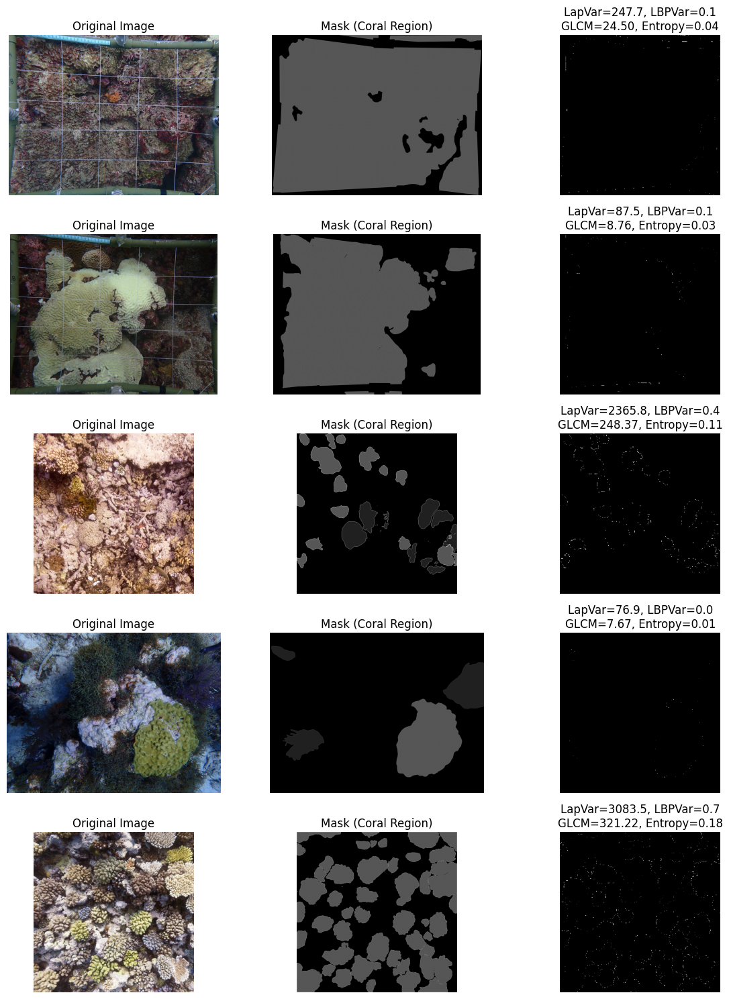

,image,lap_var,lbp_var,glcm_contrast,entropy
0,C4_Gy_PSb_T1_27nov24_CGomez_corr.jpg,247.720480,0.125099,24.504963,0.038685
1,C1_Gy_ESb_T1_27nov24_CGomez_corr.jpg,87.461486,0.119833,8.763358,0.034015
2,10001026002.jpg,2365.788880,0.414593,248.374341,0.111729
3,20220912_AnB_CB8 (26).JPG,76.927795,0.035884,7.666697,0.009725
4,15020226801.jpg,3083.530426,0.692524,321.221630,0.176557


In [ ]:
n_samples = 5  # number of examples to visualize
samples = df.sample(n_samples, random_state=42)

fig, axes = plt.subplots(n_samples, 3, figsize=(12, 3 * n_samples))

feature_data = []

for i, row in enumerate(samples.itertuples()):
    img = np.array(Image.open(row.image_path).convert("RGB"))
    mask = np.array(Image.open(row.mask_path).convert("L"))
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray_resized = cv2.resize(gray, (256, 256))
    mask_resized = cv2.resize(mask, (256, 256))

    coral_region = cv2.bitwise_and(gray_resized, gray_resized, mask=(mask_resized > 127).astype(np.uint8))

    # Compute features
    lap_var = compute_laplacian_variance(coral_region)
    lbp_var = compute_lbp_variance(coral_region)
    glcm_contrast = compute_glcm_contrast(coral_region)
    entropy = compute_entropy(coral_region)

    feature_data.append({
        "image": os.path.basename(row.image_path),
        "lap_var": lap_var,
        "lbp_var": lbp_var,
        "glcm_contrast": glcm_contrast,
        "entropy": entropy
    })

    # Plot
    axes[i, 0].imshow(img)
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(mask, cmap="gray")
    axes[i, 1].set_title("Mask (Coral Region)")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(coral_region, cmap="gray")
    axes[i, 2].set_title(
        f"LapVar={lap_var:.1f}, LBPVar={lbp_var:.1f}\nGLCM={glcm_contrast:.2f}, Entropy={entropy:.2f}"
    )
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()

feature_df = pd.DataFrame(feature_data)
display(feature_df)


- laplacian variance: shows when a coral is sharp and structurally complex (which literature says can mean its healthy and protected) or can be smooth or blurry regions which are more likely to correspond to degraded or bleached tissue.

- local binary pattern variance: similar to laplacian, but instead of just smooth or complex, it captures how diverse the coral is, meaning it could have a rich micro structure, healthy coral tends to have more texture like polyps and ridges which we have seen in many of our images, so this could show coral richness.

- gray-level co-ocurrence matrix contrast: measures local contrast between neighboring pixels, so this is similar in terms of identifying some sort of texture or smoothness, but it specifically describes how much texture intensity varies

- entropy: i believe this is what timo did correct me if im wrong and im talking about something different, this is pixen intensity randomness, global complexity of gray-level distribution, which basically shows diversity of colors or brightness.

 28%|██▊       | 28/100 [00:13<00:14,  5.04it/s]/tmp/ipython-input-3722900234.py:64: RuntimeWarning: overflow encountered in scalar add
  levels = min(max_val + 1, 256) # Ensure levels are within [0, 256] and at least 1 if max_val is 0
100%|██████████| 100/100 [02:12<00:00,  1.32s/it]

✅ Masked texture features computed on coral regions only.
            lap_var     lbp_var  glcm_contrast     entropy
count    100.000000  100.000000     100.000000  100.000000
mean    2370.877949    2.997646     213.223922    7.059369
std     2719.951191    2.376420     268.165916    0.488216
min       70.878101    0.331936       0.000000    5.607332
25%      595.713172    1.242405      49.419803    6.727417
50%     1387.675175    2.434097      99.197848    7.189000
75%     3226.171202    4.428724     310.460109    7.411294
max    19079.048996   12.971740    1529.828846    7.748652


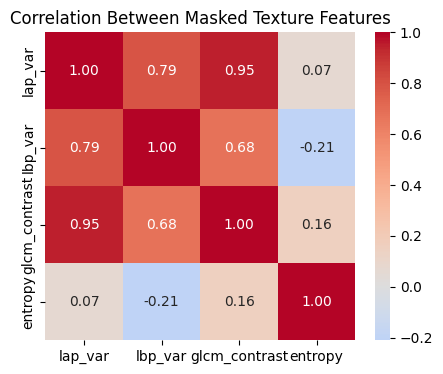

In [ ]:
import cv2
import numpy as np
import pandas as pd
from skimage.feature import local_binary_pattern, graycomatrix, graycoprops
from skimage.measure import shannon_entropy
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns

# --- Parameters for texture computation ---
RADIUS = 2
N_POINTS = 8 * RADIUS

# Function to compute features INSIDE mask region only
def extract_masked_texture_features(img_path, mask_path):
    try:
        img = cv2.imread(img_path)
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if img is None or mask is None:
            return None

        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        mask = (mask > 127).astype(np.uint8)

        # Skip empty masks
        if np.sum(mask) < 100:
            return None

        # Find bounding box of the mask
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if not contours:
            return None

        # Get the largest contour's bounding box
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # Extract the masked region as a 2D patch
        gray_patch = gray[y:y+h, x:x+w]
        mask_patch = mask[y:y+h, x:x+w]

        # Apply mask to the patch
        gray_masked_patch = cv2.bitwise_and(gray_patch, gray_patch, mask=mask_patch)

        # Ensure the masked patch is valid for calculations
        if gray_masked_patch.sum() == 0:
            return None

        # --- Compute features ---
        # Apply Laplacian on the masked patch
        lap_var = cv2.Laplacian(gray_masked_patch, cv2.CV_64F).var()

        # Compute LBP on the masked patch
        lbp = local_binary_pattern(gray_masked_patch, N_POINTS, RADIUS, method="uniform")
        lbp_var = np.var(lbp)

        # Quantize and compute GLCM on the masked patch
        # Ensure patch is not empty after masking for GLCM
        if gray_masked_patch.size == 0:
             return None

        # Adjust quantization levels based on the actual pixel values in the masked patch
        max_val = np.max(gray_masked_patch) if gray_masked_patch.size > 0 else 0
        levels = min(max_val + 1, 256) # Ensure levels are within [0, 256] and at least 1 if max_val is 0
        if levels == 0: # Handle case where max_val is 0 for an empty patch
            quantized = np.zeros_like(gray_masked_patch, dtype=np.uint8)
        else:
            quantized = np.uint8(gray_masked_patch / (256 / levels))


        if quantized.size > 0 and levels > 1: # Check if quantized image is non-empty and has more than one level
            glcm = graycomatrix(quantized, [1], [0], levels=levels, symmetric=True, normed=True)
            glcm_contrast = graycoprops(glcm, 'contrast')[0, 0]
        else:
             glcm_contrast = 0 # Assign 0 if GLCM cannot be computed


        # Compute entropy on the pixel values within the masked patch
        region_values = gray_masked_patch[mask_patch > 0]
        if region_values.size > 0:
             entropy_val = shannon_entropy(region_values)
        else:
             entropy_val = 0 # Assign 0 if entropy cannot be computed on an empty region


        return {
            "lap_var": lap_var,
            "lbp_var": lbp_var,
            "glcm_contrast": glcm_contrast,
            "entropy": entropy_val
        }

    except Exception as e:
        print(f"Error on {img_path}: {e}")
        return None

subset_df = merged_df.sample(100, random_state=42)

masked_features = []
for _, row in tqdm(subset_df.iterrows(), total=len(subset_df)):
    feats = extract_masked_texture_features(row["image_path"], row["mask_path"])
    if feats:
        feats["image"] = row["image_path"].split("/")[-1]
        masked_features.append(feats)

masked_df = pd.DataFrame(masked_features)
print("✅ Masked texture features computed on coral regions only.")
print(masked_df.describe())

# --- Correlation heatmap ---
plt.figure(figsize=(5,4))
sns.heatmap(masked_df[['lap_var','lbp_var','glcm_contrast','entropy']].corr(),
            annot=True, cmap='coolwarm', center=0, fmt=".2f")
plt.title("Correlation Between Masked Texture Features")
plt.show()

In [ ]:
import cv2, numpy as np, skimage.feature as skf, skimage.measure as skm

def compute_texture_features(img_rgb, mask):
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    gray_masked = gray * (mask > 0)

    # Laplacian variance (sharpness)
    lap_var = cv2.Laplacian(gray_masked, cv2.CV_64F).var()

    # Local Binary Pattern variance
    lbp = skf.local_binary_pattern(gray_masked, P=8, R=1, method='uniform')
    lbp_var = lbp.var()

    # GLCM contrast
    glcm = skf.graycomatrix(gray_masked, [1], [0], symmetric=True, normed=True)
    glcm_contrast = skf.graycoprops(glcm, 'contrast')[0, 0]

    # Shannon entropy
    hist, _ = np.histogram(gray_masked[mask > 0], bins=256, range=(0, 255), density=True)
    entropy = -np.sum(hist * np.log2(hist + 1e-9))

    return lap_var, lbp_var, glcm_contrast, entropy


In [ ]:
print("Current DataFrame columns:\n", df.columns.tolist())
df.head()


Current DataFrame columns:
 ['dataset', 'site', 'image_path', 'mask_path', 'mask_binary_path', 'mask_status_path']


,dataset,site,image_path,mask_path,mask_binary_path,mask_status_path
0,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN
1,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN
2,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN
3,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN
4,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN


In [ ]:
# ==============================================
# TEXTURE FEATURE EXTRACTION AND ANALYSIS
# ==============================================
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
from skimage.feature import local_binary_pattern, graycomatrix, graycoprops
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Your dataset from before
df_paths = df.copy()

records = []

print(f"🔍 Computing texture features for {len(df_paths)} images...")

for _, row in tqdm(df_paths.iterrows(), total=len(df_paths)):
    img_path = row["image_path"]
    mask_path = row["mask_path"]

    if not (img_path and mask_path):
        continue

    # Load image and mask
    img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    if img is None or mask is None:
        continue

    # Apply mask to grayscale image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray_masked = gray * (mask > 0)

    # Laplacian variance (sharpness)
    lap_var = cv2.Laplacian(gray_masked, cv2.CV_64F).var()

    # LBP variance
    lbp = local_binary_pattern(gray_masked, P=8, R=1, method='uniform')
    lbp_var = lbp.var()

    # GLCM contrast
    try:
        glcm = graycomatrix(gray_masked, [1], [0], symmetric=True, normed=True)
        glcm_contrast = graycoprops(glcm, 'contrast')[0, 0]
    except Exception:
        glcm_contrast = np.nan

    # Shannon entropy
    hist, _ = np.histogram(gray_masked[mask > 0], bins=256, range=(0, 255), density=True)
    entropy = -np.sum(hist * np.log2(hist + 1e-9))

    records.append({
        "dataset": row["dataset"],
        "split": row["split"],
        "image_path": img_path,
        "lap_var": lap_var,
        "lbp_var": lbp_var,
        "glcm_contrast": glcm_contrast,
        "entropy": entropy
    })

# Create new DataFrame
features_df = pd.DataFrame(records)
features_df.to_csv("/content/drive/MyDrive/01_data/texture_features.csv", index=False)

print(f"✅ Extracted features for {len(features_df)} samples.")
display(features_df.head())

# ==============================================
# VISUALIZATIONS
# ==============================================

# --- Histograms
features_df[["lap_var", "lbp_var", "glcm_contrast", "entropy"]].hist(figsize=(10,8), bins=20)
plt.suptitle("Distribution of Texture Features")
plt.show()

# --- Correlation Heatmap
plt.figure(figsize=(6,5))
sns.heatmap(features_df[["lap_var", "lbp_var", "glcm_contrast", "entropy"]].corr(),
            annot=True, cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Correlation Matrix of Texture Features")
plt.show()

# --- Scatterplot Matrix
sns.pairplot(features_df[["lap_var", "lbp_var", "glcm_contrast", "entropy"]],
             corner=True, diag_kind='kde')
plt.suptitle("Scatterplot Matrix of Texture Features", y=1.02)
plt.show()

# --- PCA Visualization
X_scaled = StandardScaler().fit_transform(features_df[["lap_var", "lbp_var", "glcm_contrast", "entropy"]].fillna(0))
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2'])
pca_df['dataset'] = features_df['dataset']

plt.figure(figsize=(7,5))
sns.scatterplot(data=pca_df, x="PC1", y="PC2", hue="dataset", s=40, alpha=0.7)
plt.title("PCA of Texture Features Across Datasets")
plt.show()


🔍 Computing texture features for 3276 images...


  1%|          | 20/3276 [02:35<7:01:08,  7.76s/it]


KeyboardInterrupt: 

In [ ]:
import pandas as pd

DATA_PATH = "/content/drive/MyDrive/coral_project_outputs/merged_dataset.csv"
df = pd.read_csv(DATA_PATH)

print("✅ Loaded base dataset:", len(df), "samples")
display(df.head())


✅ Loaded base dataset: 11066 samples


,dataset,site,image_path,mask_path,mask_binary_path,mask_status_path
0,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN
1,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN
2,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN
3,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN
4,benthic,SEAFLOWER_BOLIVAR,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/01_data/benthic_dataset...,/content/drive/MyDrive/coral_project_outputs/n...,NaN


In [ ]:
import cv2
import numpy as np
from tqdm import tqdm

records = []

print(f"🔍 Computing Laplacian variance for {len(df)} images...")

lap_values = []
for _, row in tqdm(df.iterrows(), total=len(df)):
    img_path = row["image_path"]
    mask_path = row["mask_path"]

    if not (isinstance(img_path, str) and isinstance(mask_path, str)):
        lap_values.append(np.nan)
        continue

    img = cv2.imread(img_path)
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    if img is None or mask is None:
        lap_values.append(np.nan)
        continue

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    masked = gray * (mask > 0)

    lap_var = cv2.Laplacian(masked, cv2.CV_64F).var()
    lap_values.append(lap_var)

df["lap_var"] = lap_values
print("✅ Added Laplacian variance to dataset.")


🔍 Computing Laplacian variance for 3276 images...


100%|██████████| 3276/3276 [1:23:32<00:00,  1.53s/it]

✅ Added Laplacian variance to dataset.


In [ ]:
SAVE_PATH = "/content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap.csv"
df.to_csv(SAVE_PATH, index=False)
print(f"💾 Saved updated dataset to: {SAVE_PATH}")


💾 Saved updated dataset to: /content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap.csv


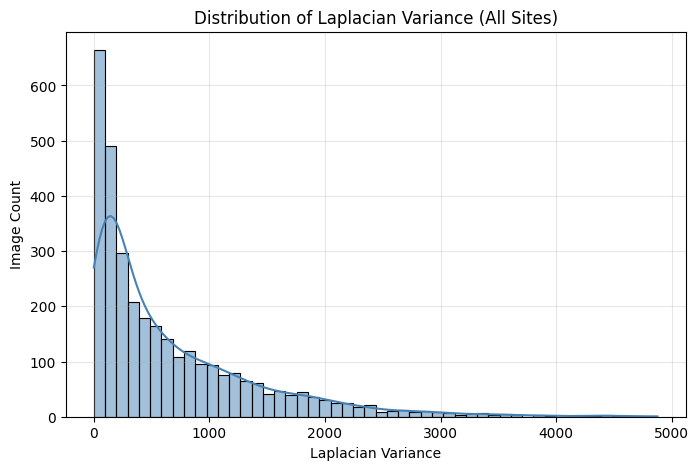

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(8,5))
sns.histplot(df["lap_var"].dropna(), bins=50, kde=True, color="steelblue")
plt.title("Distribution of Laplacian Variance (All Sites)")
plt.xlabel("Laplacian Variance")
plt.ylabel("Image Count")
plt.grid(alpha=0.3)
plt.show()


/tmp/ipython-input-4265031027.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dataset", y="lap_var", data=df, showfliers=False, palette="crest")


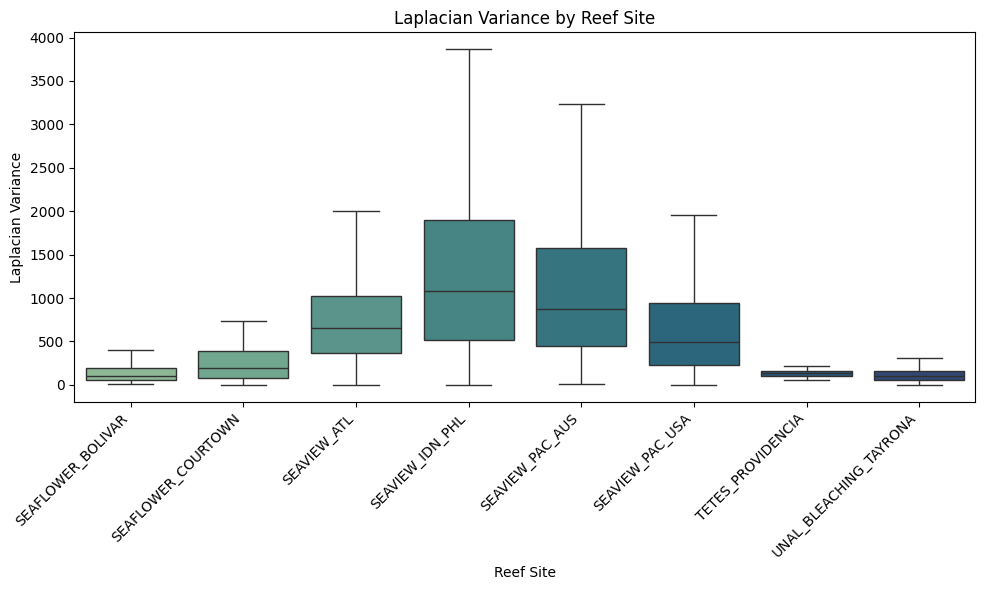

In [ ]:
plt.figure(figsize=(10,6))
sns.boxplot(x="dataset", y="lap_var", data=df, showfliers=False, palette="crest")
plt.xticks(rotation=45, ha='right')
plt.title("Laplacian Variance by Reef Site")
plt.xlabel("Reef Site")
plt.ylabel("Laplacian Variance")
plt.tight_layout()
plt.show()


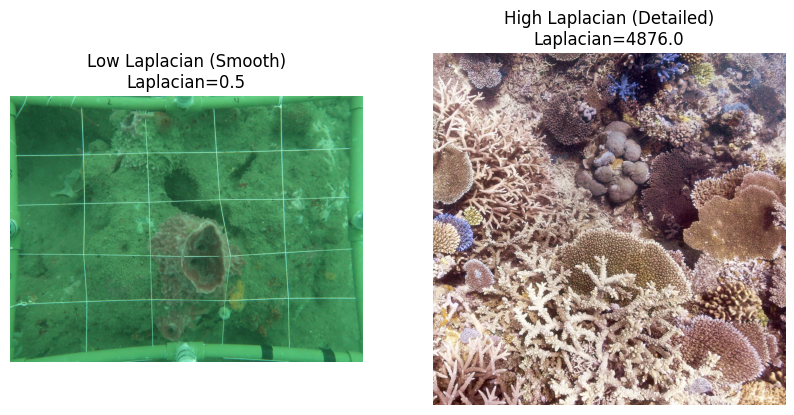

In [ ]:
import cv2
import matplotlib.pyplot as plt

low_sample = df.nsmallest(1, "lap_var").iloc[0]
high_sample = df.nlargest(1, "lap_var").iloc[0]

def show_image_pair(row1, row2, label1, label2):
    img1 = cv2.cvtColor(cv2.imread(row1["image_path"]), cv2.COLOR_BGR2RGB)
    img2 = cv2.cvtColor(cv2.imread(row2["image_path"]), cv2.COLOR_BGR2RGB)
    fig, axs = plt.subplots(1,2,figsize=(10,5))
    axs[0].imshow(img1)
    axs[0].set_title(f"{label1}\nLaplacian={row1['lap_var']:.1f}")
    axs[1].imshow(img2)
    axs[1].set_title(f"{label2}\nLaplacian={row2['lap_var']:.1f}")
    for ax in axs: ax.axis('off')
    plt.show()

show_image_pair(low_sample, high_sample, "Low Laplacian (Smooth)", "High Laplacian (Detailed)")


In [ ]:
import cv2
import numpy as np
import pandas as pd
from skimage.feature import local_binary_pattern
from tqdm import tqdm

# Load the dataset you already saved
DATA_PATH = "/content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap.csv"
df = pd.read_csv(DATA_PATH)

print(f" Loaded dataset with Laplacian: {len(df)} samples")

# Parameters for LBP
radius = 2
n_points = 8 * radius

lbp_vars = []

for _, row in tqdm(df.iterrows(), total=len(df)):
    img_path = row["image_path"]
    mask_path = row["mask_path"]

    try:
        img = cv2.imread(img_path)
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if img is None or mask is None:
            lbp_vars.append(np.nan)
            continue

        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        masked = gray * (mask > 0)

        # Compute LBP
        lbp = local_binary_pattern(masked, n_points, radius, method='uniform')

        # Compute variance only within coral mask
        masked_lbp = lbp[mask > 0]
        lbp_var = np.var(masked_lbp) if len(masked_lbp) > 0 else np.nan

        lbp_vars.append(lbp_var)
    except Exception as e:
        lbp_vars.append(np.nan)
        print(f" Error at {img_path}: {e}")

# Add to dataframe
df["lbp_var"] = lbp_vars
print(" LBP variance added.")

# Save new version
SAVE_PATH = "/content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap_lbp.csv"
df.to_csv(SAVE_PATH, index=False)
print(f" Saved updated dataset to: {SAVE_PATH}")


✅ Loaded dataset with Laplacian: 3276 samples


100%|██████████| 3276/3276 [1:42:37<00:00,  1.88s/it]

✅ LBP variance added.
💾 Saved updated dataset to: /content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap_lbp.csv


In [ ]:
import pandas as pd

# Load the dataset with both Laplacian + LBP
df = pd.read_csv("/content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap_lbp.csv")

# Summary stats
stats = df[["lap_var", "lbp_var"]].describe().T
stats["skewness"] = df[["lap_var", "lbp_var"]].skew()
stats["kurtosis"] = df[["lap_var", "lbp_var"]].kurtosis()
display(stats)

# Correlation matrix
corr = df[["lap_var", "lbp_var"]].corr()
print("\n📈 Correlation between Laplacian and LBP variance:")
display(corr)


,count,mean,std,min,25%,50%,75%,max,skewness,kurtosis
lap_var,3276.0,663.000827,742.570045,0.522626,124.762056,382.960461,969.194234,4875.968053,1.836308,3.991335
lbp_var,3276.0,35.903916,3.464848,22.927357,33.512981,36.001417,38.492017,48.575845,-0.158347,-0.165801



📈 Correlation between Laplacian and LBP variance:


,lap_var,lbp_var
lap_var,1.000000,0.238857
lbp_var,0.238857,1.000000


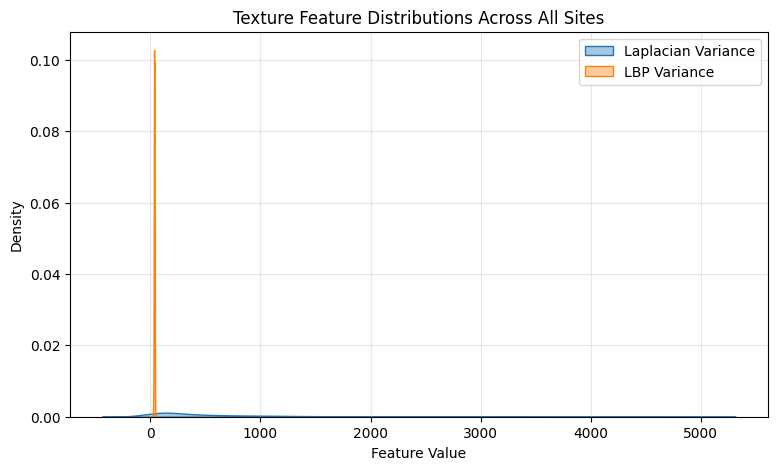

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(9,5))
sns.kdeplot(df["lap_var"], label="Laplacian Variance", fill=True, alpha=0.4)
sns.kdeplot(df["lbp_var"], label="LBP Variance", fill=True, alpha=0.4)
plt.title("Texture Feature Distributions Across All Sites")
plt.xlabel("Feature Value")
plt.ylabel("Density")
plt.legend()
plt.grid(alpha=0.3)
plt.show()


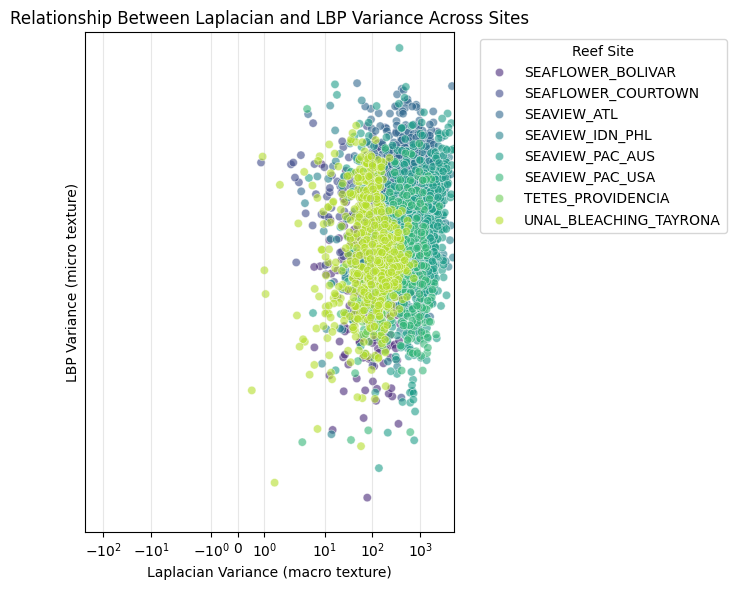

In [ ]:
plt.figure(figsize=(7,6))
sns.scatterplot(data=df, x="lap_var", y="lbp_var", hue="dataset", palette="viridis", alpha=0.6)
plt.xscale("symlog")
plt.yscale("symlog")
plt.title("Relationship Between Laplacian and LBP Variance Across Sites")
plt.xlabel("Laplacian Variance (macro texture)")
plt.ylabel("LBP Variance (micro texture)")
plt.legend(bbox_to_anchor=(1.05,1), title="Reef Site")
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


In [ ]:
plt.figure(figsize=(12,5))
sns.boxplot(data=pd.melt(df, id_vars="dataset", value_vars="lbp_var"),
            x="dataset", y="value", hue="variable", palette="crest", showfliers=False)
plt.xticks(rotation=45, ha='right')
plt.title("Distribution of Texture Features by Reef Site")
plt.ylabel("Feature Value")
plt.xlabel("Reef Site")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()


KeyError: "The following id_vars or value_vars are not present in the DataFrame: ['lbp_var']"

<Figure size 1200x500 with 0 Axes>

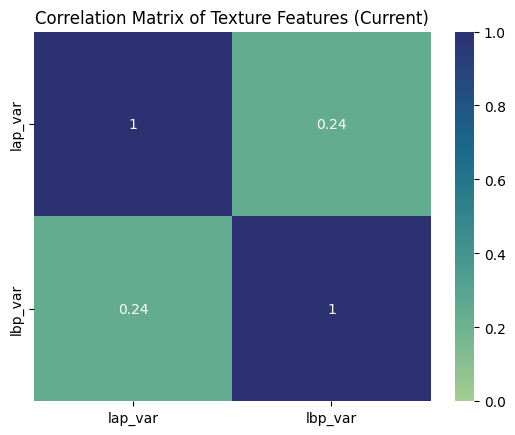

In [ ]:
sns.heatmap(df[["lap_var","lbp_var"]].corr(), annot=True, cmap="crest", vmin=0, vmax=1)
plt.title("Correlation Matrix of Texture Features (Current)")
plt.show()


In [ ]:
import cv2
import numpy as np
import pandas as pd
from skimage.feature import graycomatrix, graycoprops
from tqdm import tqdm

# Load dataset with Laplacian + LBP
df = pd.read_csv("/content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap_lbp.csv")

glcm_contrasts = []

for _, row in tqdm(df.iterrows(), total=len(df)):
    try:
        img = cv2.imread(row["image_path"])
        mask = cv2.imread(row["mask_path"], cv2.IMREAD_GRAYSCALE)

        if img is None or mask is None:
            glcm_contrasts.append(np.nan)
            continue

        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        masked = cv2.bitwise_and(gray, gray, mask=(mask > 0).astype(np.uint8))

        # Normalize gray to 8-bit (required by skimage)
        gray_norm = cv2.normalize(masked, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

        # Compute GLCM
        glcm = graycomatrix(gray_norm, distances=[1], angles=[0], symmetric=True, normed=True)
        contrast = graycoprops(glcm, 'contrast')[0, 0]

        glcm_contrasts.append(contrast)
    except Exception as e:
        glcm_contrasts.append(np.nan)
        print(f"⚠️ Error at {row['image_path']}: {e}")

df["glcm_contrast"] = glcm_contrasts

# Save the updated dataset
SAVE_PATH = "/content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap_lbp_glcm.csv"
df.to_csv(SAVE_PATH, index=False)
print(f"✅ GLCM contrast added and saved to {SAVE_PATH}")


100%|██████████| 3276/3276 [44:35<00:00,  1.22it/s]


✅ GLCM contrast added and saved to /content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap_lbp_glcm.csv


In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Load dataset with Laplacian + LBP + GLCM
df = pd.read_csv("/content/drive/MyDrive/coral_project_outputs/merged_dataset_with_lap_lbp_glcm.csv")

# Basic info
print("✅ Loaded dataset:", df.shape)
print(df[["lap_var","lbp_var","glcm_contrast"]].describe())


✅ Loaded dataset: (3276, 7)
           lap_var      lbp_var  glcm_contrast
count  3276.000000  3276.000000    3276.000000
mean    663.000827    35.903916     113.533957
std     742.570045     3.464848     122.150751
min       0.522626    22.927357       0.168075
25%     124.762056    33.512981      27.983883
50%     382.960461    36.001417      69.166105
75%     969.194234    38.492017     161.213695
max    4875.968053    48.575845     852.559602


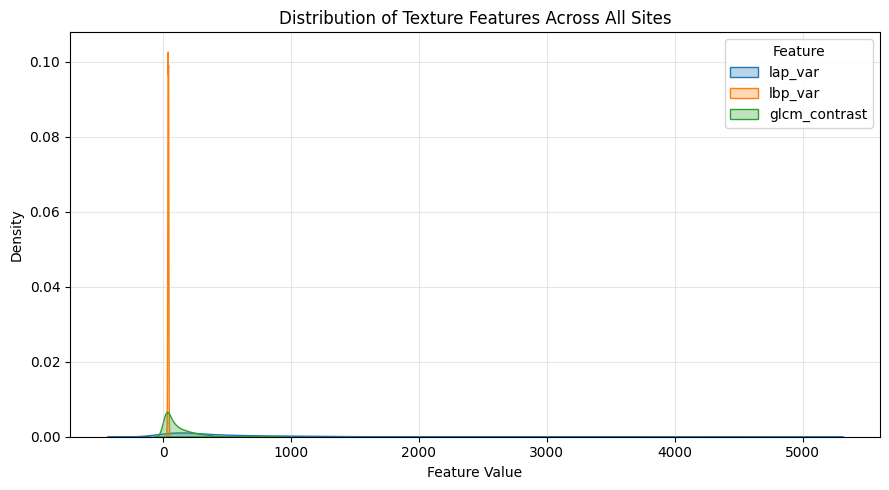

In [ ]:
plt.figure(figsize=(9,5))
for feat, color in zip(["lap_var","lbp_var","glcm_contrast"], ["#1f77b4","#ff7f0e","#2ca02c"]):
    sns.kdeplot(df[feat].dropna(), label=feat, fill=True, alpha=0.3, color=color)

plt.title("Distribution of Texture Features Across All Sites")
plt.xlabel("Feature Value")
plt.ylabel("Density")
plt.legend(title="Feature")
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


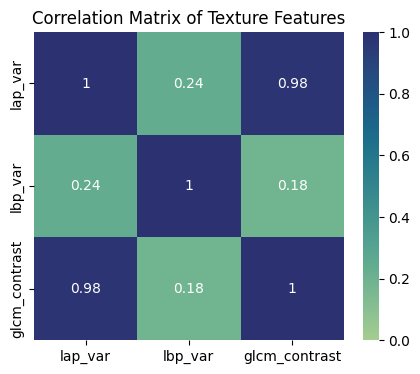

In [ ]:
corr = df[["lap_var","lbp_var","glcm_contrast"]].corr()

plt.figure(figsize=(5,4))
sns.heatmap(corr, annot=True, cmap="crest", vmin=0, vmax=1)
plt.title("Correlation Matrix of Texture Features")
plt.show()


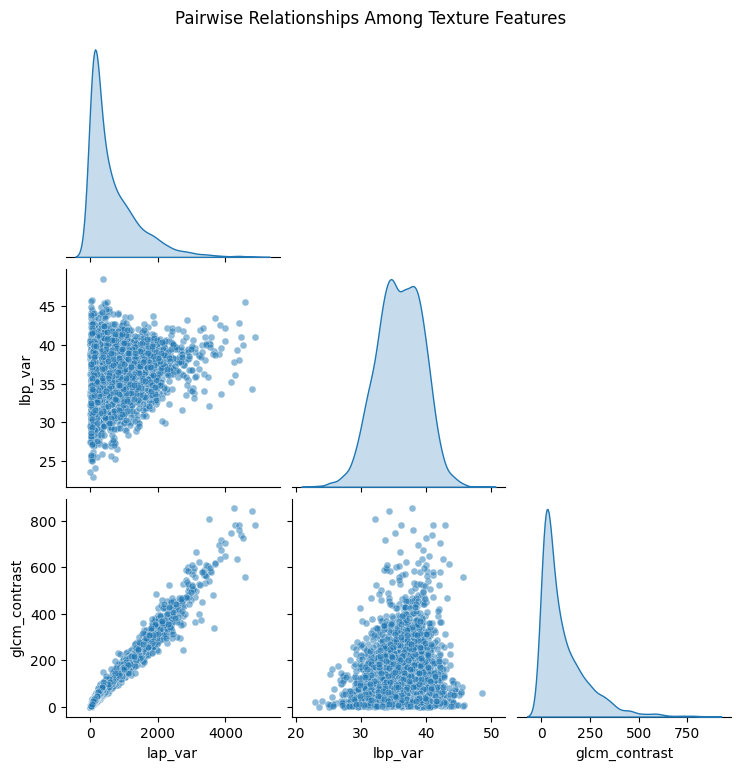

In [ ]:
sns.pairplot(df[["lap_var","lbp_var","glcm_contrast"]].dropna(), diag_kind="kde", corner=True, plot_kws={'alpha':0.5, 's':25})
plt.suptitle("Pairwise Relationships Among Texture Features", y=1.02)
plt.show()


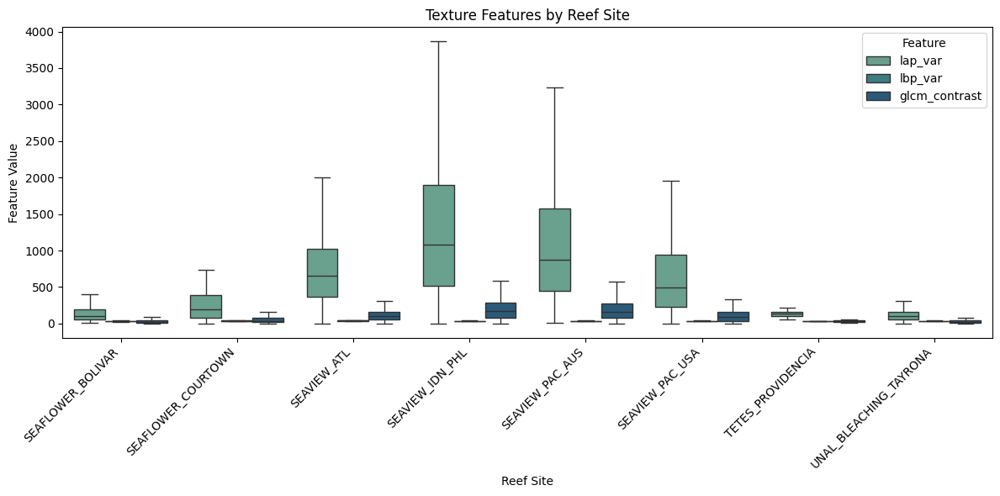

In [ ]:
melted = pd.melt(df, id_vars="dataset", value_vars=["lap_var","lbp_var","glcm_contrast"], var_name="Feature", value_name="Value")

plt.figure(figsize=(12,6))
sns.boxplot(data=melted, x="dataset", y="Value", hue="Feature", palette="crest", showfliers=False)
plt.xticks(rotation=45, ha="right")
plt.title("Texture Features by Reef Site")
plt.ylabel("Feature Value")
plt.xlabel("Reef Site")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()


In [ ]:
import cv2
import numpy as np
import pandas as pd
from skimage.feature import local_binary_pattern
from tqdm import tqdm
import os

# === Paths ===
dataset_path = "/content/drive/MyDrive/coral_project_outputs/merged_dataset.csv"
df = pd.read_csv(dataset_path)

output_csv = "/content/drive/MyDrive/coral_project_outputs/texture_features_gray_masked.csv"

# Ensure valid paths
df = df[df['image_path'].notna() & df['mask_path'].notna()].reset_index(drop=True)

# LBP parameters
RADIUS = 2
POINTS = 8 * RADIUS

lap_vals, lbp_vals = [], []

for i, row in tqdm(df.iterrows(), total=len(df), desc="Computing masked Laplacian + LBP (gray)"):
    img_path = row['image_path']
    mask_path = row['mask_path']

    try:
        # Load grayscale image and binary mask
        gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

        if gray is None or mask is None:
            lap_vals.append(np.nan)
            lbp_vals.append(np.nan)
            continue

        # Optional resize for consistency
        gray = cv2.resize(gray, (512, 512))
        mask = cv2.resize(mask, (512, 512))

        # Normalize mask (0–1)
        mask = (mask > 127).astype(np.uint8)

        # Apply mask to grayscale image
        coral_region = cv2.bitwise_and(gray, gray, mask=mask)

        # Skip empty masks
        if mask.sum() == 0:
            lap_vals.append(np.nan)
            lbp_vals.append(np.nan)
            continue

        # Compute Laplacian variance only on coral region
        lap = cv2.Laplacian(coral_region, cv2.CV_64F)
        lap_var = lap[mask == 1].var()  # masked variance

        # Compute LBP only on coral region
        lbp = local_binary_pattern(gray, POINTS, RADIUS, method="uniform")
        lbp_var = lbp[mask == 1].var()

        lap_vals.append(lap_var)
        lbp_vals.append(lbp_var)

    except Exception as e:
        print(f"⚠️ Error in {img_path}: {e}")
        lap_vals.append(np.nan)
        lbp_vals.append(np.nan)

# Add new columns
df["lap_var_gray_masked"] = lap_vals
df["lbp_var_gray_masked"] = lbp_vals

# Save results
df.to_csv(output_csv, index=False)
print(f"✅ Saved mask-based grayscale features to: {output_csv}")


Computing masked Laplacian + LBP (gray): 100%|██████████| 3276/3276 [20:01<00:00,  2.73it/s]

✅ Saved mask-based grayscale features to: /content/drive/MyDrive/coral_project_outputs/texture_features_gray_masked.csv


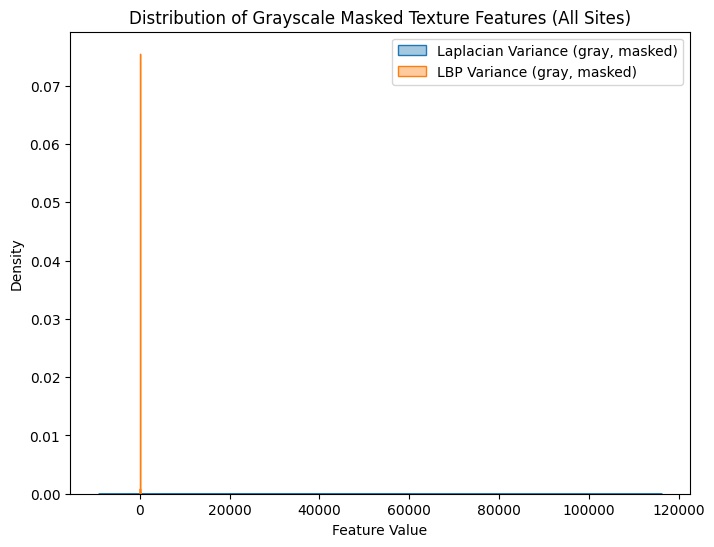

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,6))
sns.kdeplot(df["lap_var_gray_masked"].dropna(), label="Laplacian Variance (gray, masked)", fill=True, alpha=0.4)
sns.kdeplot(df["lbp_var_gray_masked"].dropna(), label="LBP Variance (gray, masked)", fill=True, alpha=0.4)
plt.title("Distribution of Grayscale Masked Texture Features (All Sites)")
plt.xlabel("Feature Value")
plt.ylabel("Density")
plt.legend()
plt.show()


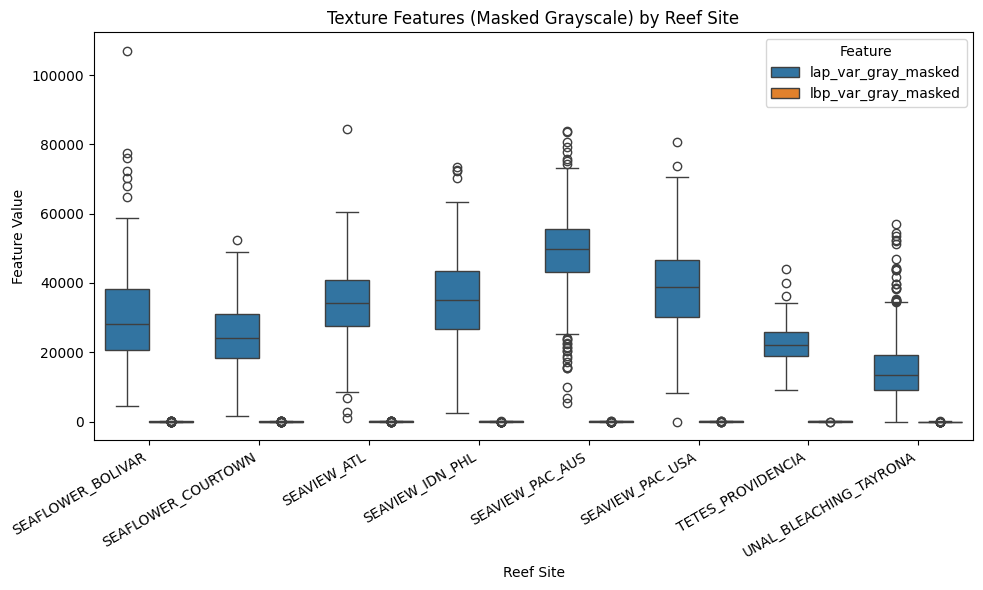

In [ ]:
plt.figure(figsize=(10,6))
df_melt = df.melt(id_vars=["dataset"],
                  value_vars=["lap_var_gray_masked", "lbp_var_gray_masked"],
                  var_name="Feature", value_name="Value")

sns.boxplot(data=df_melt, x="dataset", y="Value", hue="Feature")
plt.title("Texture Features (Masked Grayscale) by Reef Site")
plt.xlabel("Reef Site")
plt.ylabel("Feature Value")
plt.xticks(rotation=30, ha='right')
plt.tight_layout()
plt.show()


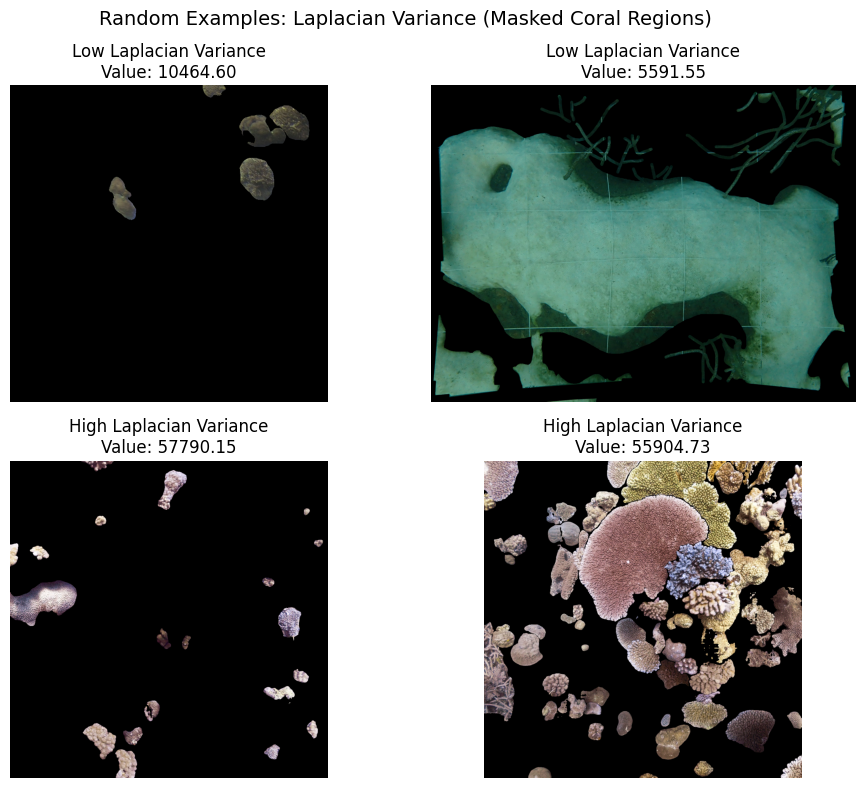

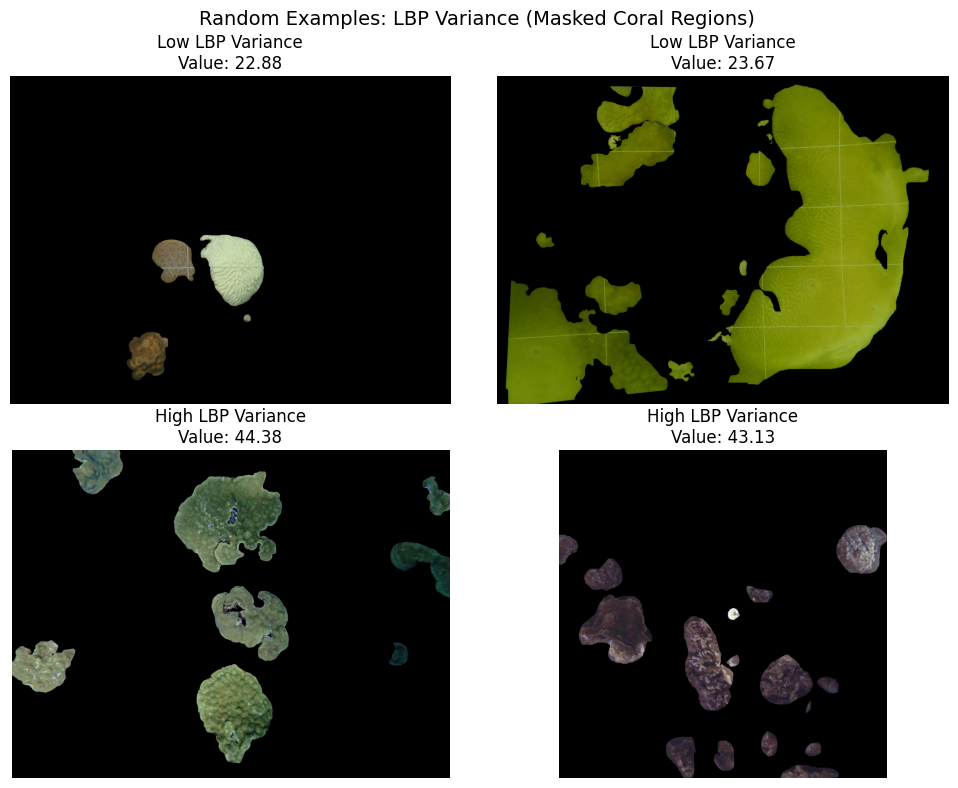

In [ ]:
import random
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

def show_texture_examples(df, feature_col, title_feature, n_samples=1):
    """
    Displays random low and high examples based on a given feature.
    Args:
        df: DataFrame containing 'image_path' and 'mask_path'
        feature_col: Column name of the feature (e.g., 'lap_var_gray_masked')
        title_feature: Title string for plot
        n_samples: number of random examples to show per category
    """
    # Filter rows with valid feature values
    df_valid = df[df[feature_col].notna()]

    # Randomly choose samples from lowest 10% and highest 10%
    low_cutoff = df_valid[feature_col].quantile(0.1)
    high_cutoff = df_valid[feature_col].quantile(0.9)

    low_samples = df_valid[df_valid[feature_col] <= low_cutoff].sample(n=n_samples, random_state=random.randint(0,10000))
    high_samples = df_valid[df_valid[feature_col] >= high_cutoff].sample(n=n_samples, random_state=random.randint(0,10000))

    # Combine them for display
    samples = pd.concat([low_samples.assign(Level="Low"), high_samples.assign(Level="High")])

    fig, axes = plt.subplots(2, n_samples, figsize=(5*n_samples, 8))
    if n_samples == 1:
        axes = np.array([[axes[0]], [axes[1]]])  # handle case with n=1

    for col_idx, (_, row) in enumerate(samples.iterrows()):
        img = cv2.imread(row["image_path"])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(row["mask_path"], cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, (img.shape[1], img.shape[0]))
        img_masked = cv2.bitwise_and(img, img, mask=mask)

        ax = axes[0 if row["Level"]=="Low" else 1, col_idx % n_samples]
        ax.imshow(img_masked)
        ax.set_title(f"{row['Level']} {title_feature}\nValue: {row[feature_col]:.2f}")
        ax.axis("off")

    plt.suptitle(f"Random Examples: {title_feature} (Masked Coral Regions)", fontsize=14)
    plt.tight_layout()
    plt.show()

# Example usage — choose random examples each run
show_texture_examples(df, "lap_var_gray_masked", "Laplacian Variance", n_samples=2)
show_texture_examples(df, "lbp_var_gray_masked", "LBP Variance", n_samples=2)


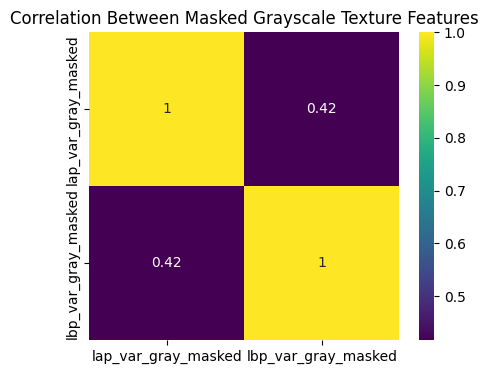

In [ ]:
plt.figure(figsize=(5,4))
sns.heatmap(df[["lap_var_gray_masked","lbp_var_gray_masked"]].corr(), annot=True, cmap="viridis")
plt.title("Correlation Between Masked Grayscale Texture Features")
plt.show()


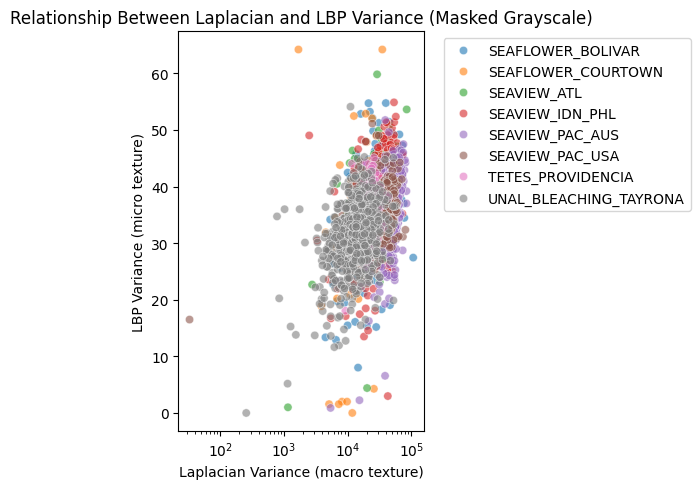

In [ ]:
plt.figure(figsize=(6,5))
sns.scatterplot(data=df, x="lap_var_gray_masked", y="lbp_var_gray_masked", hue="dataset", alpha=0.6)
plt.xscale("log")
plt.title("Relationship Between Laplacian and LBP Variance (Masked Grayscale)")
plt.xlabel("Laplacian Variance (macro texture)")
plt.ylabel("LBP Variance (micro texture)")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


✅ Loaded 3248 samples with Laplacian & LBP (gray, masked)


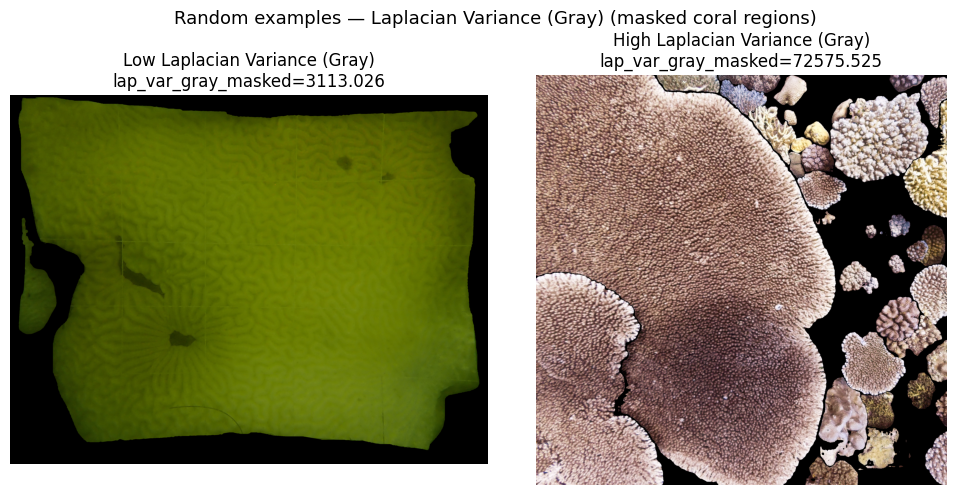

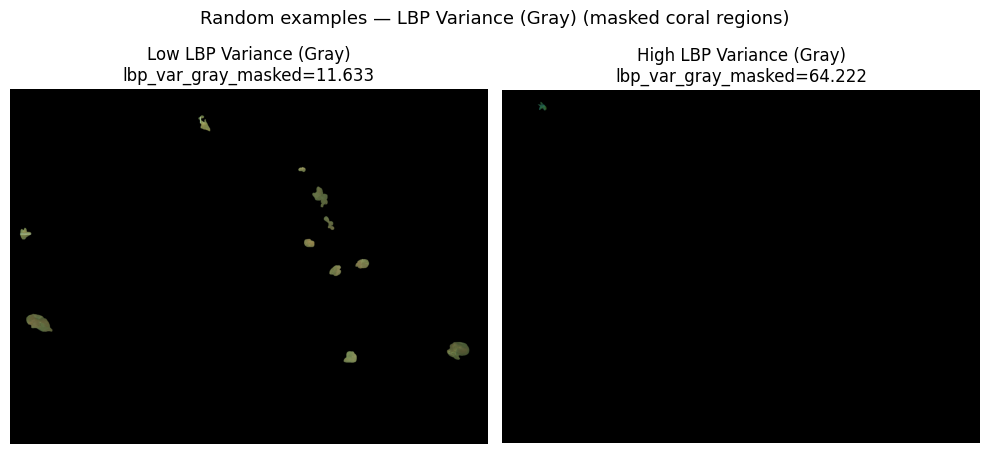

<Figure size 1000x400 with 0 Axes>

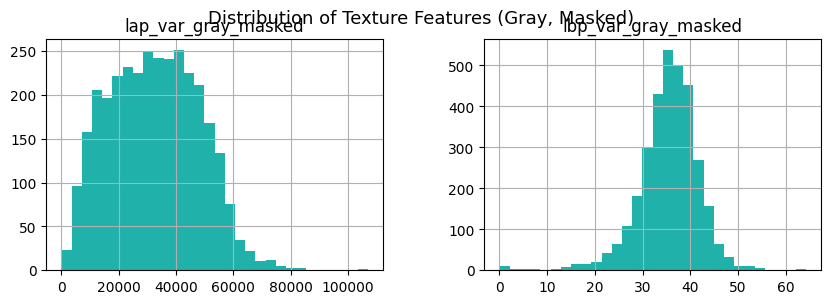

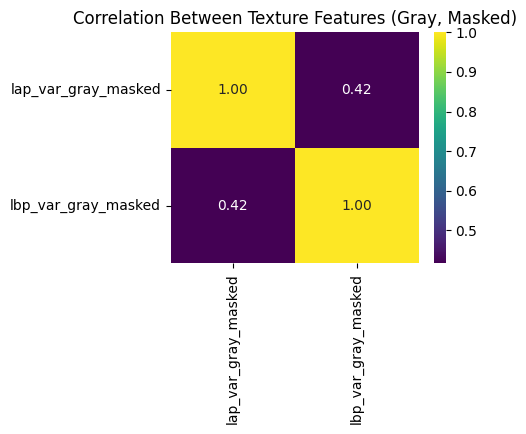

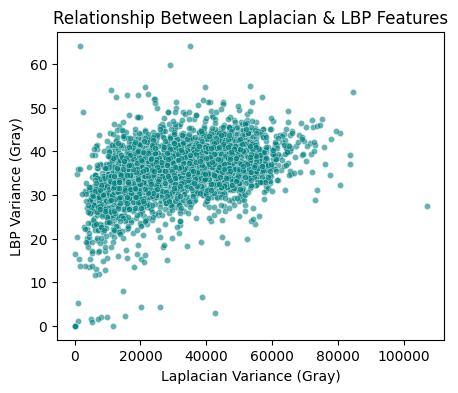

In [ ]:
import pandas as pd
import numpy as np
import cv2
import random
import matplotlib.pyplot as plt
import seaborn as sns

# === Load your computed grayscale-masked feature dataset ===
df = pd.read_csv("/content/drive/MyDrive/coral_project_outputs/texture_features_gray_masked.csv")

# Keep only samples that have valid image + mask paths
df = df.dropna(subset=["image_path", "mask_path", "lap_var_gray_masked", "lbp_var_gray_masked"])
print(f"✅ Loaded {len(df)} samples with Laplacian & LBP (gray, masked)")

# -----------------------------------------------------------
# 1️⃣ Random low/high examples for Laplacian & LBP
# -----------------------------------------------------------
def show_random_examples(df, feature_col, title):
    """Displays a random low-value and high-value example for a given feature."""
    low = df.nsmallest(20, feature_col).sample(1).iloc[0]
    high = df.nlargest(20, feature_col).sample(1).iloc[0]

    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    for ax, row, label in zip(axes, [low, high], ["Low", "High"]):
        img = cv2.imread(row["image_path"])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(row["mask_path"], cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, (img.shape[1], img.shape[0]))
        img_masked = cv2.bitwise_and(img, img, mask=mask)

        ax.imshow(img_masked)
        ax.set_title(f"{label} {title}\n{feature_col}={row[feature_col]:.3f}")
        ax.axis("off")

    plt.suptitle(f"Random examples — {title} (masked coral regions)", fontsize=13)
    plt.tight_layout()
    plt.show()

# Run examples
show_random_examples(df, "lap_var_gray_masked", "Laplacian Variance (Gray)")
show_random_examples(df, "lbp_var_gray_masked", "LBP Variance (Gray)")

# -----------------------------------------------------------
# 2️⃣ Feature histograms
# -----------------------------------------------------------
plt.figure(figsize=(10, 4))
df[["lap_var_gray_masked", "lbp_var_gray_masked"]].hist(bins=30, color='lightseagreen', figsize=(10, 3))
plt.suptitle("Distribution of Texture Features (Gray, Masked)", fontsize=13)
plt.show()

# -----------------------------------------------------------
# 3️⃣ Correlation heatmap
# -----------------------------------------------------------
corr = df[["lap_var_gray_masked", "lbp_var_gray_masked"]].corr()
plt.figure(figsize=(4,3))
sns.heatmap(corr, annot=True, cmap="viridis", fmt=".2f")
plt.title("Correlation Between Texture Features (Gray, Masked)")
plt.show()

# -----------------------------------------------------------
# 4️⃣ Scatter relationship
# -----------------------------------------------------------
plt.figure(figsize=(5,4))
sns.scatterplot(
    x=df["lap_var_gray_masked"],
    y=df["lbp_var_gray_masked"],
    alpha=0.6,
    s=20,
    color="teal"
)
plt.xlabel("Laplacian Variance (Gray)")
plt.ylabel("LBP Variance (Gray)")
plt.title("Relationship Between Laplacian & LBP Features")
plt.show()


In [ ]:
# ================================================================
# SECTION: Compute Texture Features vs Bleaching Percentage
# ================================================================
import os, cv2
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from tqdm import tqdm

# --- Paths ---
BASE_PATH = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA"
OUTPUT_PATH = "/content/drive/MyDrive/coral_project_outputs"

img_dir = os.path.join(BASE_PATH, "images")
mask_bleached_dir = os.path.join(BASE_PATH, "masks_bleached")
mask_nonbleached_dir = os.path.join(BASE_PATH, "masks_non_bleached")

# --- Feature computation functions ---
def compute_lbp(img_gray):
    lbp = local_binary_pattern(img_gray, P=8, R=1, method='uniform')
    return np.var(lbp)

def compute_laplacian(img_gray):
    lap = cv2.Laplacian(img_gray, cv2.CV_64F)
    return lap.var()

# --- Process all bleaching dataset images ---
records = []
img_files = sorted([f for f in os.listdir(img_dir) if f.lower().endswith((".jpg", ".png"))])

for fname in tqdm(img_files, desc="Processing bleaching dataset"):
    stem = os.path.splitext(fname)[0]
    img_path = os.path.join(img_dir, fname)
    mask_b_path = os.path.join(mask_bleached_dir, f"{stem}_bleached.png")
    mask_nb_path = os.path.join(mask_nonbleached_dir, f"{stem}_non_bleached.png")

    if not (os.path.exists(mask_b_path) and os.path.exists(mask_nb_path)):
        continue

    # Load image and masks
    img = cv2.imread(img_path)
    mask_b = cv2.imread(mask_b_path, cv2.IMREAD_GRAYSCALE)
    mask_nb = cv2.imread(mask_nb_path, cv2.IMREAD_GRAYSCALE)
    if img is None or mask_b is None or mask_nb is None:
        continue

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Combined coral mask
    coral_mask = ((mask_b > 0) | (mask_nb > 0)).astype(np.uint8)
    if coral_mask.sum() == 0:
        continue

    # Compute features only inside coral regions
    gray_masked = cv2.bitwise_and(gray, gray, mask=coral_mask)

    lap_var = compute_laplacian(gray_masked)
    lbp_var = compute_lbp(gray_masked)

    total_coral = np.sum(mask_b > 0) + np.sum(mask_nb > 0)
    perc_bleached = (np.sum(mask_b > 0) / total_coral * 100.0) if total_coral > 0 else 0
    has_bleached = perc_bleached > 0

    records.append({
        "image": fname,
        "lap_var_gray_masked": lap_var,
        "lbp_var_gray_masked": lbp_var,
        "perc_bleached": perc_bleached,
        "has_bleached": has_bleached
    })

# --- Build dataframe ---
df_bleach_feat = pd.DataFrame(records)
print(f"✅ Computed texture features for {len(df_bleach_feat)} images")

# Save CSV
out_csv = os.path.join(OUTPUT_PATH, "bleaching_texture_features.csv")
df_bleach_feat.to_csv(out_csv, index=False)
print(f"📦 Saved features to {out_csv}")

# ================================================================
# VISUALIZATIONS
# ================================================================
if len(df_bleach_feat) > 0:
    # 1️⃣ Scatter: Laplacian vs LBP
    plt.figure(figsize=(7,6))
    sns.scatterplot(data=df_bleach_feat,
                    x="lap_var_gray_masked",
                    y="lbp_var_gray_masked",
                    hue="has_bleached",
                    palette={True: "red", False: "gray"})
    plt.title("Laplacian vs LBP Variance — Bleached vs Non-Bleached")
    plt.xlabel("Laplacian Variance (Sharpness)")
    plt.ylabel("LBP Variance (Microtexture)")
    plt.legend(title="Bleached Present")
    plt.show()

    # 2️⃣ Histogram: Bleached coverage
    plt.figure(figsize=(8,4))
    sns.histplot(df_bleach_feat["perc_bleached"], bins=30, color="orange")
    plt.title("Distribution of % Coral Area Bleached")
    plt.xlabel("% Coral Area Bleached")
    plt.ylabel("Frequency")
    plt.show()

    # 3️⃣ Regression: % Bleaching vs Features
    plt.figure(figsize=(8,6))
    sns.regplot(data=df_bleach_feat, x="perc_bleached", y="lap_var_gray_masked",
                color="royalblue", label="Laplacian", scatter_kws={"s":30})
    sns.regplot(data=df_bleach_feat, x="perc_bleached", y="lbp_var_gray_masked",
                color="green", label="LBP", scatter_kws={"s":30})
    plt.title("Texture Features vs % Coral Bleached")
    plt.xlabel("% Coral Area Bleached")
    plt.ylabel("Feature Value")
    plt.legend()
    plt.show()

    # 4️⃣ Correlation heatmap
    corr = df_bleach_feat[["lap_var_gray_masked", "lbp_var_gray_masked", "perc_bleached"]].corr()
    plt.figure(figsize=(4,3))
    sns.heatmap(corr, annot=True, cmap="coolwarm", fmt=".2f")
    plt.title("Correlation Matrix: Texture Features & Bleaching")
    plt.show()


Processing bleaching dataset:   0%|          | 3/658 [00:17<1:04:03,  5.87s/it]


KeyboardInterrupt: 

In [ ]:
# ================================================================
# SECTION: Add GLCM Texture Features for Bleaching Dataset
# ================================================================
from skimage.feature import graycomatrix, graycoprops

def compute_glcm_features(gray_masked):
    gray = cv2.normalize(gray_masked, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    glcm = graycomatrix(gray, distances=[1, 2],
                        angles=[0, np.pi/4, np.pi/2, 3*np.pi/4],
                        levels=256, symmetric=True, normed=True)
    return {
        "glcm_contrast": graycoprops(glcm, "contrast").mean(),
        "glcm_homogeneity": graycoprops(glcm, "homogeneity").mean(),
        "glcm_energy": graycoprops(glcm, "energy").mean(),
        "glcm_correlation": graycoprops(glcm, "correlation").mean()
    }

# Reload your saved features
df_bleach_feat = pd.read_csv(os.path.join(OUTPUT_PATH, "bleaching_texture_features.csv"))
print(f"Loaded {len(df_bleach_feat)} bleaching images for GLCM computation")

# Compute GLCM for each image again
glcm_records = []
for i, row in tqdm(df_bleach_feat.iterrows(), total=len(df_bleach_feat), desc="Computing GLCM"):
    fname = row["image"]
    img_path = os.path.join(img_dir, fname)
    mask_b_path = os.path.join(mask_bleached_dir, f"{os.path.splitext(fname)[0]}_bleached.png")
    mask_nb_path = os.path.join(mask_nonbleached_dir, f"{os.path.splitext(fname)[0]}_non_bleached.png")

    if not (os.path.exists(img_path) and os.path.exists(mask_b_path) and os.path.exists(mask_nb_path)):
        glcm_records.append({k: np.nan for k in ["glcm_contrast","glcm_homogeneity","glcm_energy","glcm_correlation"]})
        continue

    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    mask_b = cv2.imread(mask_b_path, cv2.IMREAD_GRAYSCALE)
    mask_nb = cv2.imread(mask_nb_path, cv2.IMREAD_GRAYSCALE)
    if img is None or mask_b is None or mask_nb is None:
        glcm_records.append({k: np.nan for k in ["glcm_contrast","glcm_homogeneity","glcm_energy","glcm_correlation"]})
        continue

    coral_mask = ((mask_b > 0) | (mask_nb > 0)).astype(np.uint8)
    gray_masked = cv2.bitwise_and(img, img, mask=coral_mask)
    feats = compute_glcm_features(gray_masked)
    glcm_records.append(feats)

# Merge new features
df_glcm = pd.DataFrame(glcm_records)
df_bleach_feat = pd.concat([df_bleach_feat, df_glcm], axis=1)

# Save
out_csv_glcm = os.path.join(OUTPUT_PATH, "bleaching_texture_features_with_glcm.csv")
df_bleach_feat.to_csv(out_csv_glcm, index=False)
print(f"✅ Saved combined bleaching texture features to {out_csv_glcm}")


Loaded 634 bleaching images for GLCM computation


Computing GLCM: 100%|██████████| 634/634 [03:53<00:00,  2.72it/s]

✅ Saved combined bleaching texture features to /content/drive/MyDrive/coral_project_outputs/bleaching_texture_features_with_glcm.csv


✅ Loaded 634 bleaching samples for correlation analysis


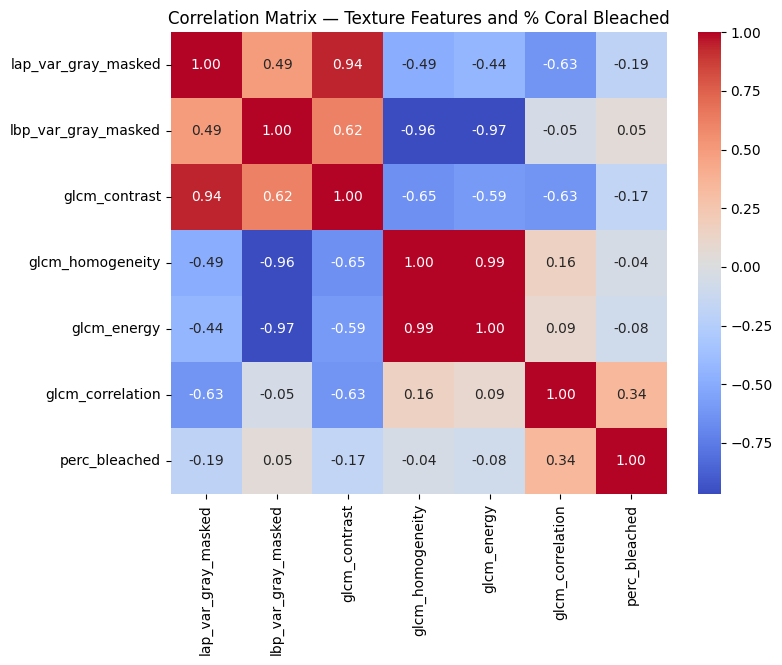

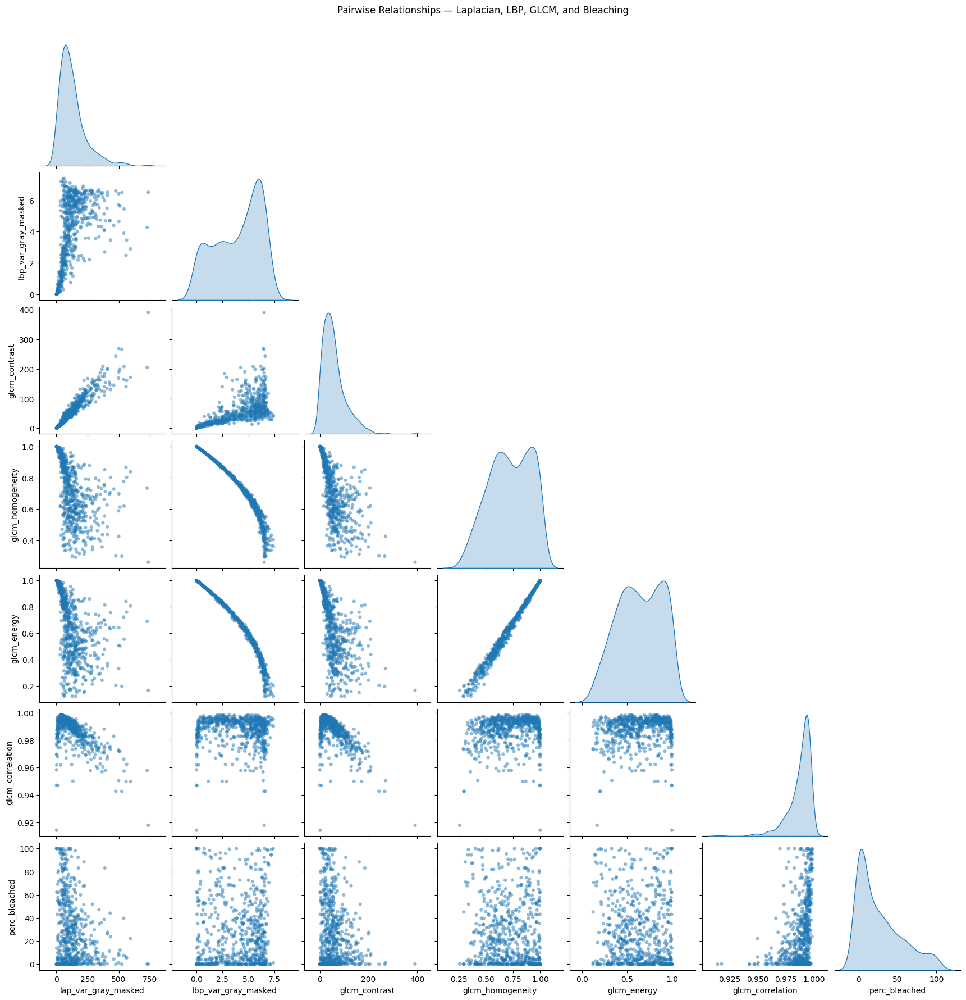

/tmp/ipython-input-2796916438.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=corr_with_bleaching.values, y=corr_with_bleaching.index, palette="coolwarm")


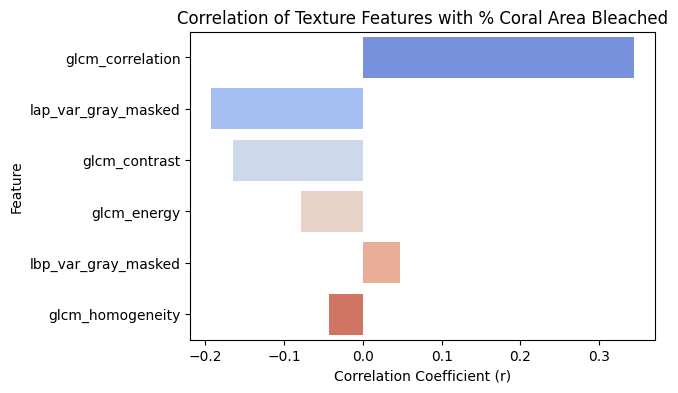

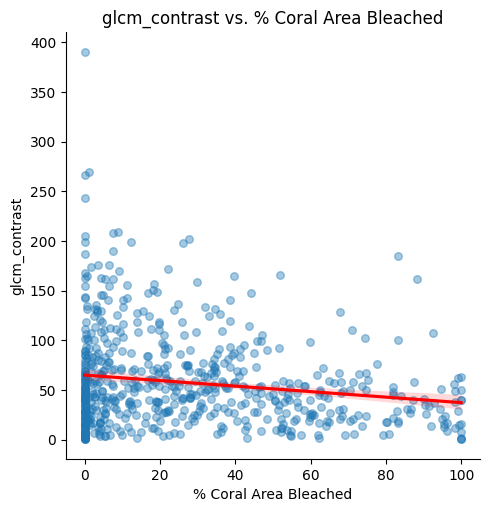

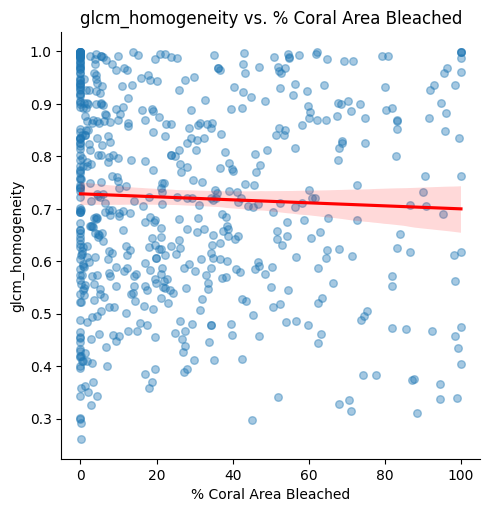

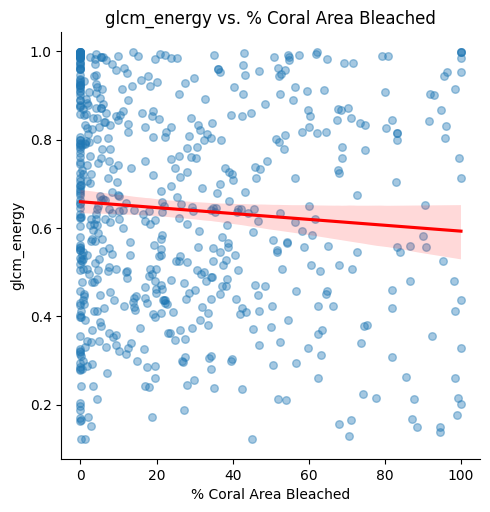

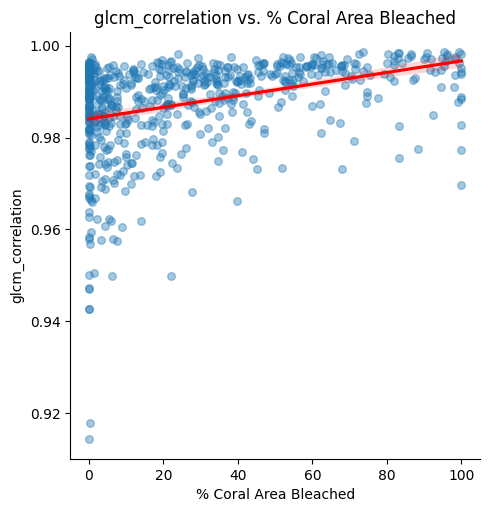

In [ ]:
# ================================================================
# SECTION: Correlation and Visualization — All Texture Features
# ================================================================
df = pd.read_csv(os.path.join(OUTPUT_PATH, "bleaching_texture_features_with_glcm.csv"))
print(f"✅ Loaded {len(df)} bleaching samples for correlation analysis")

# Drop rows with missing values
df_clean = df.dropna(subset=[
    "lap_var_gray_masked", "lbp_var_gray_masked",
    "glcm_contrast", "glcm_homogeneity", "glcm_energy", "glcm_correlation"
])

# ---- Correlation Matrix ----
features = ["lap_var_gray_masked", "lbp_var_gray_masked",
            "glcm_contrast", "glcm_homogeneity", "glcm_energy", "glcm_correlation",
            "perc_bleached"]

corr = df_clean[features].corr()

plt.figure(figsize=(8,6))
sns.heatmap(corr, annot=True, cmap="coolwarm", fmt=".2f", cbar=True)
plt.title("Correlation Matrix — Texture Features and % Coral Bleached")
plt.show()

# ---- Pairwise scatter relationships ----
sns.pairplot(df_clean[features], corner=True, diag_kind="kde",
             plot_kws={"alpha":0.5, "s":20, "edgecolor":"none"})
plt.suptitle("Pairwise Relationships — Laplacian, LBP, GLCM, and Bleaching", y=1.02)
plt.show()

# ---- Individual feature correlations with bleaching ----
corr_with_bleaching = corr["perc_bleached"].drop("perc_bleached").sort_values(key=abs, ascending=False)

plt.figure(figsize=(6,4))
sns.barplot(x=corr_with_bleaching.values, y=corr_with_bleaching.index, palette="coolwarm")
plt.title("Correlation of Texture Features with % Coral Area Bleached")
plt.xlabel("Correlation Coefficient (r)")
plt.ylabel("Feature")
plt.show()

# ---- Focused regression plots ----
for feat in ["glcm_contrast", "glcm_homogeneity", "glcm_energy", "glcm_correlation"]:
    sns.lmplot(data=df_clean, x="perc_bleached", y=feat,
               scatter_kws={"alpha":0.4, "s":30}, line_kws={"color":"red"})
    plt.title(f"{feat} vs. % Coral Area Bleached")
    plt.xlabel("% Coral Area Bleached")
    plt.ylabel(feat)
    plt.show()


In [ ]:
# --- Paths ---
BASE_PATH = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA"
OUTPUT_PATH = "/content/drive/MyDrive/coral_project_outputs"

✅ Loaded 634 bleaching samples for correlation analysis
📊 After balancing: 525 bleached + 16 non-bleached = 541 total


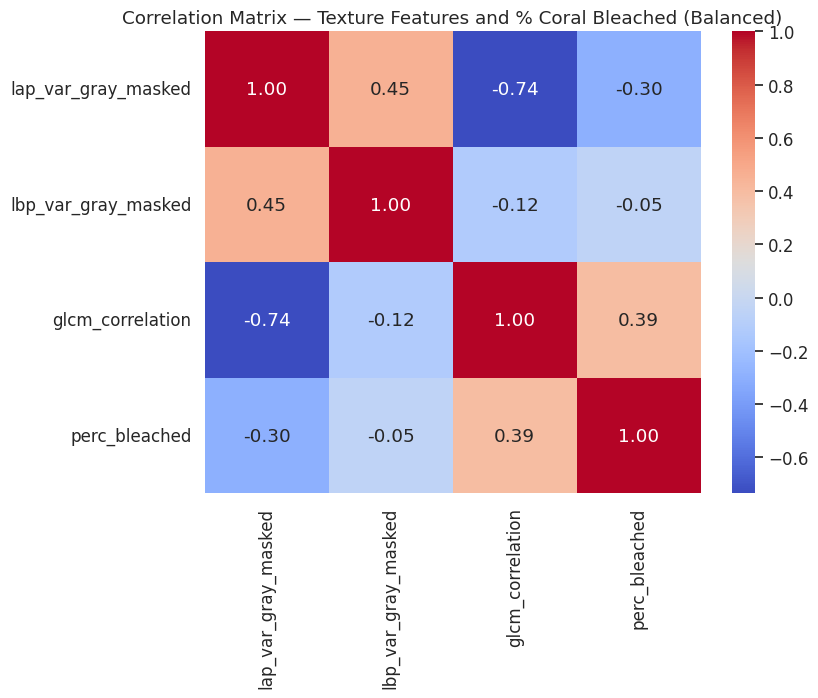

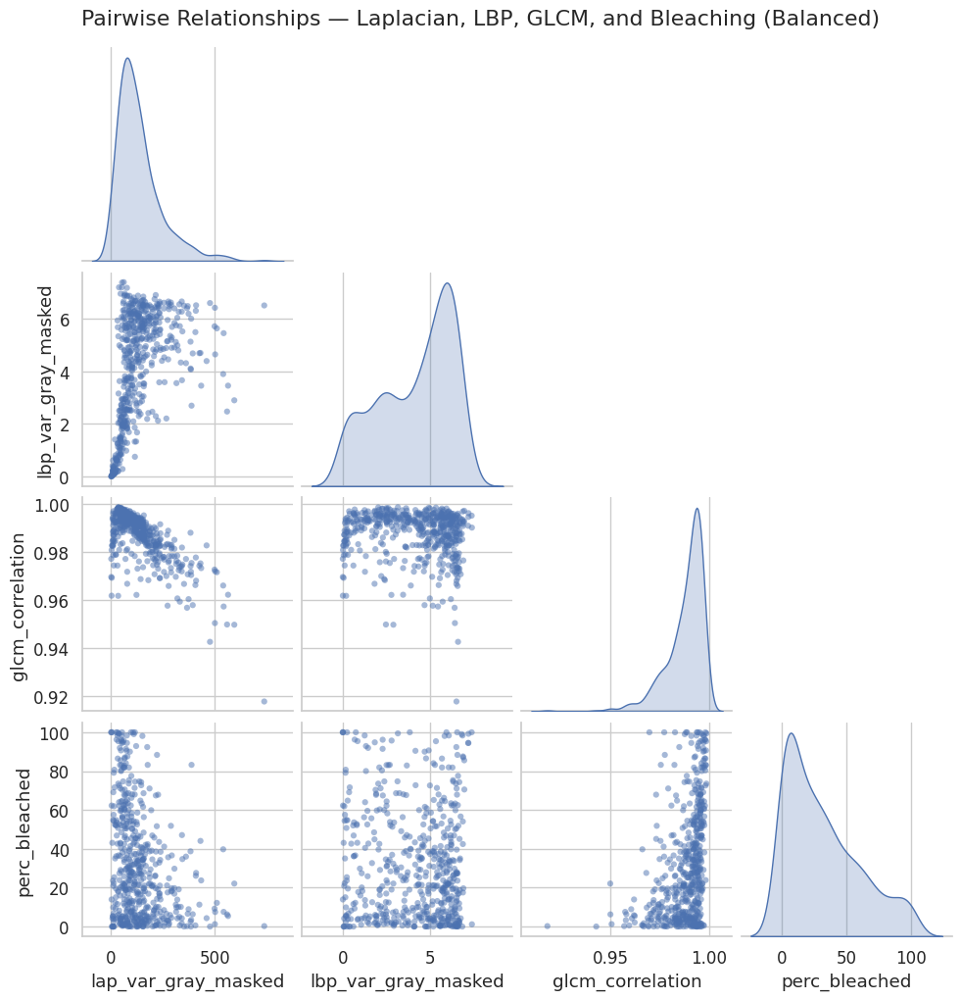

/tmp/ipython-input-2774652942.py:50: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=corr_with_bleaching.values, y=corr_with_bleaching.index, palette="coolwarm")


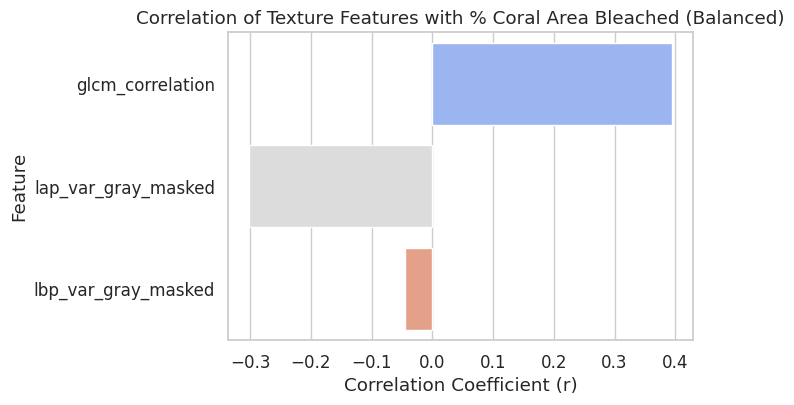

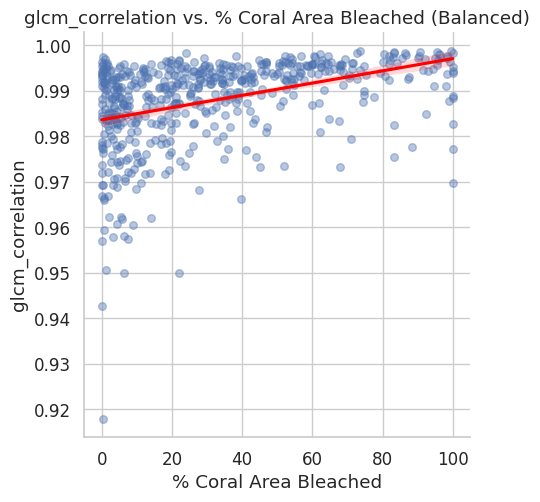

In [ ]:
# ================================================================
# SECTION: Correlation and Visualization — All Texture Features (Balanced)
# ================================================================
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os

# --- Load dataset ---
df = pd.read_csv(os.path.join(OUTPUT_PATH, "bleaching_texture_features_with_glcm.csv"))
print(f"✅ Loaded {len(df)} bleaching samples for correlation analysis")

# --- Clean missing values ---
df_clean = df.dropna(subset=[
    "lap_var_gray_masked", "lbp_var_gray_masked",
    "glcm_contrast", "glcm_homogeneity", "glcm_energy", "glcm_correlation"
])

# --- Balance dataset (reduce dominance of non-bleached) ---
non_bleached = df_clean[df_clean["perc_bleached"] == 0]
bleached = df_clean[df_clean["perc_bleached"] > 0]

# Randomly sample only half of the non-bleached samples
non_bleached_sample = non_bleached.sample(frac=0.15, random_state=42)
df_balanced = pd.concat([bleached, non_bleached_sample]).reset_index(drop=True)

print(f"📊 After balancing: {len(bleached)} bleached + {len(non_bleached_sample)} non-bleached = {len(df_balanced)} total")

# --- Correlation Matrix ---
features = ["lap_var_gray_masked", "lbp_var_gray_masked", "glcm_correlation", "perc_bleached"]

corr = df_balanced[features].corr()

plt.figure(figsize=(8,6))
sns.heatmap(corr, annot=True, cmap="coolwarm", fmt=".2f", cbar=True)
plt.title("Correlation Matrix — Texture Features and % Coral Bleached (Balanced)")
plt.show()

# --- Pairwise scatter relationships ---
sns.pairplot(df_balanced[features], corner=True, diag_kind="kde",
             plot_kws={"alpha":0.5, "s":20, "edgecolor":"none"})
plt.suptitle("Pairwise Relationships — Laplacian, LBP, GLCM, and Bleaching (Balanced)", y=1.02)
plt.show()

# --- Individual feature correlations with bleaching ---
corr_with_bleaching = corr["perc_bleached"].drop("perc_bleached").sort_values(key=abs, ascending=False)

plt.figure(figsize=(6,4))
sns.barplot(x=corr_with_bleaching.values, y=corr_with_bleaching.index, palette="coolwarm")
plt.title("Correlation of Texture Features with % Coral Area Bleached (Balanced)")
plt.xlabel("Correlation Coefficient (r)")
plt.ylabel("Feature")
plt.show()

# --- Focused regression plots ---
for feat in ["glcm_correlation"]:
    sns.lmplot(data=df_balanced, x="perc_bleached", y=feat,
               scatter_kws={"alpha":0.4, "s":30}, line_kws={"color":"red"})
    plt.title(f"{feat} vs. % Coral Area Bleached (Balanced)")
    plt.xlabel("% Coral Area Bleached")
    plt.ylabel(feat)
    plt.show()


✅ Loaded 634 bleaching samples for correlation analysis
📊 Equalizing to 53 samples per bleaching range
✅ Balanced dataset created: 212 total (4 bins × 53 samples each)


/tmp/ipython-input-3248610830.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_clean.groupby("bleach_range", group_keys=False)
/tmp/ipython-input-3248610830.py:32: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.sample(n=min_count, random_state=42))


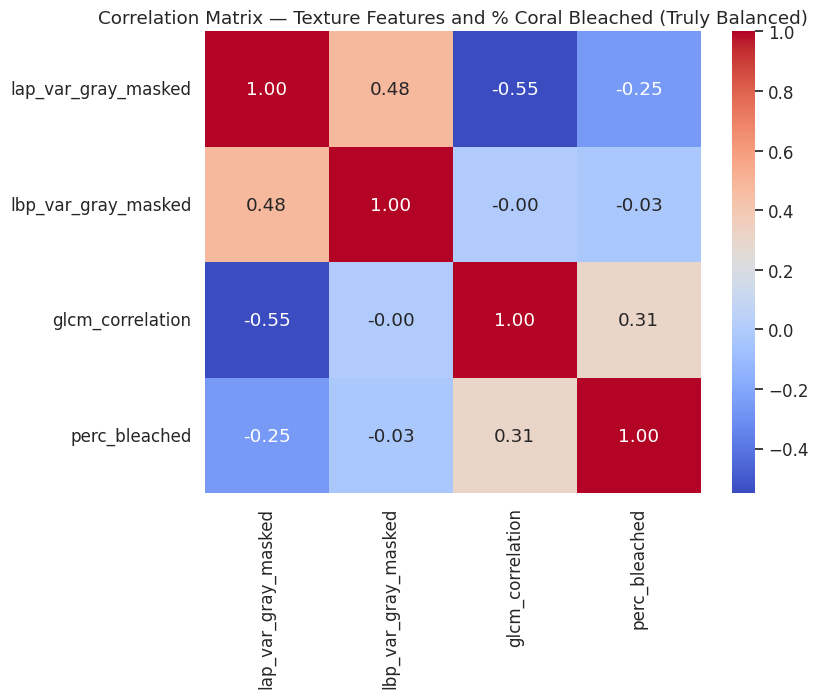

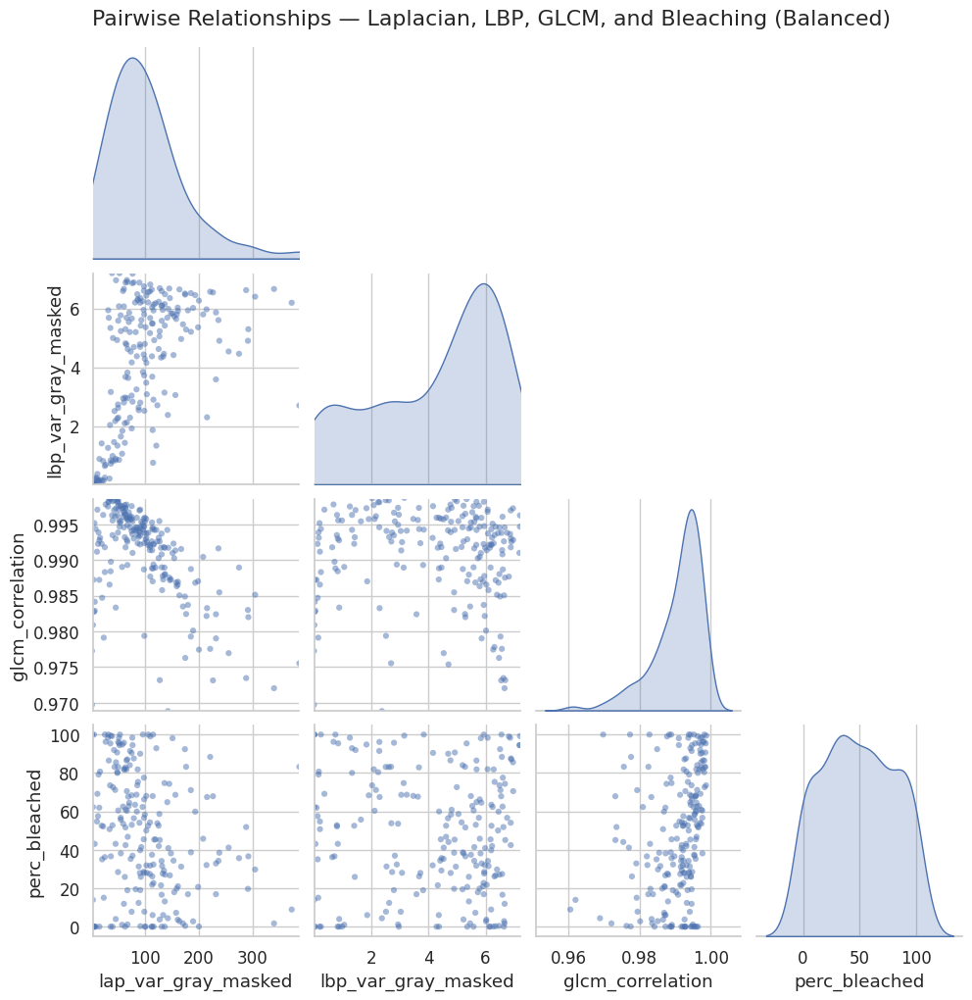

/tmp/ipython-input-3248610830.py:72: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=corr_with_bleaching.values, y=corr_with_bleaching.index, palette="coolwarm")


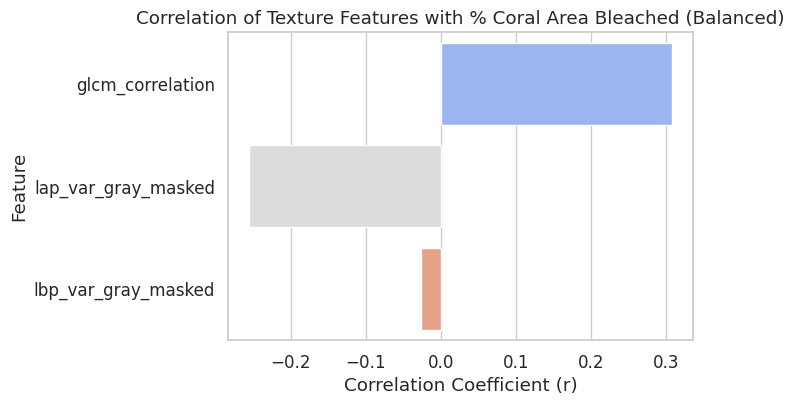

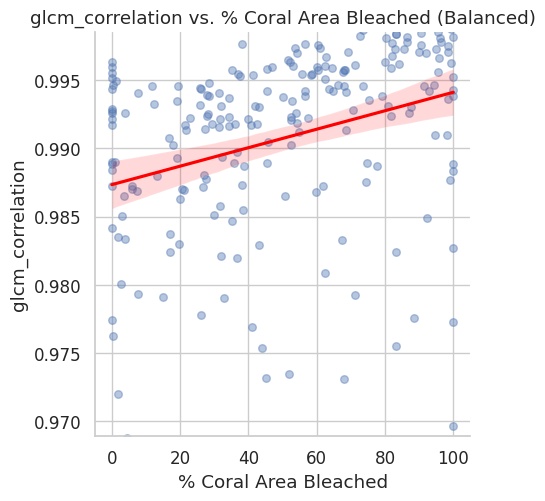

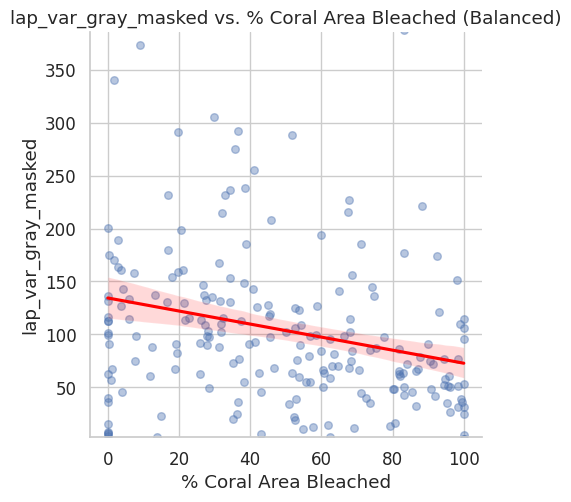

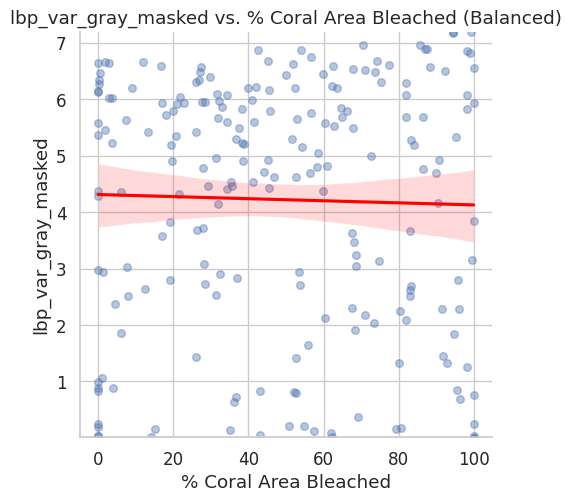

In [ ]:
# ================================================================
# SECTION: Correlation and Visualization — All Texture Features (Truly Balanced)
# ================================================================
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os

# --- Load dataset ---
df = pd.read_csv(os.path.join(OUTPUT_PATH, "bleaching_texture_features_with_glcm.csv"))
print(f"✅ Loaded {len(df)} bleaching samples for correlation analysis")

# --- Clean missing values ---
df_clean = df.dropna(subset=[
    "lap_var_gray_masked", "lbp_var_gray_masked",
    "glcm_contrast", "glcm_homogeneity", "glcm_energy", "glcm_correlation", "perc_bleached"
])

# --- Bin bleaching percentage into ranges ---
bins = [0, 25, 50, 75, 100]  # You can refine these if your data distribution is uneven
labels = ["0–25%", "26–50%", "51–75%", "76–100%"]
df_clean["bleach_range"] = pd.cut(df_clean["perc_bleached"], bins=bins, labels=labels, include_lowest=True)

# --- Count per bin and balance ---
bin_counts = df_clean["bleach_range"].value_counts().sort_index()
min_count = bin_counts.min()
print(f"📊 Equalizing to {min_count} samples per bleaching range")

df_balanced = (
    df_clean.groupby("bleach_range", group_keys=False)
    .apply(lambda x: x.sample(n=min_count, random_state=42))
    .reset_index(drop=True)
)

print(f"✅ Balanced dataset created: {len(df_balanced)} total ({len(labels)} bins × {min_count} samples each)")

# --- Correlation Matrix ---
features = ["lap_var_gray_masked", "lbp_var_gray_masked", "glcm_correlation", "perc_bleached"]

corr = df_balanced[features].corr()
plt.figure(figsize=(8,6))
sns.heatmap(corr, annot=True, cmap="coolwarm", fmt=".2f", cbar=True)
plt.title("Correlation Matrix — Texture Features and % Coral Bleached (Truly Balanced)")
plt.show()

# --- Compute percentile-based axis limits ---
axis_limits = {}
for f in features:
    if f != "perc_bleached":
        low, high = df_balanced[f].quantile([0.01, 0.99])
        axis_limits[f] = (low, high)

# --- Pairwise scatter relationships (focused) ---
g = sns.pairplot(df_balanced[features], corner=True, diag_kind="kde",
                 plot_kws={"alpha":0.5, "s":20, "edgecolor":"none"})
g.fig.suptitle("Pairwise Relationships — Laplacian, LBP, GLCM, and Bleaching (Balanced)", y=1.02)

# Apply tighter axes
for i, f1 in enumerate(features[:-1]):
    for j, f2 in enumerate(features[:-1]):
        if i > j:
            ax = g.axes[i, j]
            ax.set_xlim(axis_limits[f2])
            ax.set_ylim(axis_limits[f1])

plt.show()

# --- Individual feature correlations with bleaching ---
corr_with_bleaching = corr["perc_bleached"].drop("perc_bleached").sort_values(key=abs, ascending=False)
plt.figure(figsize=(6,4))
sns.barplot(x=corr_with_bleaching.values, y=corr_with_bleaching.index, palette="coolwarm")
plt.title("Correlation of Texture Features with % Coral Area Bleached (Balanced)")
plt.xlabel("Correlation Coefficient (r)")
plt.ylabel("Feature")
plt.show()

# --- Focused regression plots with limited y-range ---
for feat in ["glcm_correlation", "lap_var_gray_masked", "lbp_var_gray_masked"]:
    low, high = df_balanced[feat].quantile([0.01, 0.99])
    sns.lmplot(data=df_balanced, x="perc_bleached", y=feat,
               scatter_kws={"alpha":0.4, "s":30}, line_kws={"color":"red"})
    plt.ylim(low, high)
    plt.title(f"{feat} vs. % Coral Area Bleached (Balanced)")
    plt.xlabel("% Coral Area Bleached")
    plt.ylabel(feat)
    plt.show()


In [ ]:
# ================================================================
# Standardize Selected Texture Features for Health Score Demo
# ================================================================
import pandas as pd
from sklearn.preprocessing import StandardScaler

# --- Paths ---
INPUT_PATH = "/content/drive/MyDrive/coral_project_outputs/bleaching_texture_features_with_glcm.csv"
OUTPUT_PATH = "/content/drive/MyDrive/coral_project_outputs/bleaching_texture_features_standardized.csv"

# --- Load dataset ---
df = pd.read_csv(INPUT_PATH)
print(f"✅ Loaded {len(df)} samples")

# --- Keep only relevant columns ---
keep_cols = [
    "image",
    "lap_var_gray_masked",
    "lbp_var_gray_masked",
    "glcm_correlation",
    "perc_bleached",
    "has_bleached"
]
df = df[keep_cols]

# --- Standardize selected features ---
scaler = StandardScaler()
features_to_scale = ["lap_var_gray_masked", "lbp_var_gray_masked", "glcm_correlation"]

scaled_values = scaler.fit_transform(df[features_to_scale])
scaled_df = pd.DataFrame(
    scaled_values,
    columns=[f"{c}_std" for c in features_to_scale]
)

# --- Concatenate standardized columns back to dataframe ---
df_std = pd.concat([df.reset_index(drop=True), scaled_df], axis=1)

# --- Save clean standardized dataset ---
df_std.to_csv(OUTPUT_PATH, index=False)
print(f"📦 Saved standardized dataset to: {OUTPUT_PATH}")
display(df_std.head())


✅ Loaded 634 samples
📦 Saved standardized dataset to: /content/drive/MyDrive/coral_project_outputs/bleaching_texture_features_standardized.csv


,image,lap_var_gray_masked,lbp_var_gray_masked,glcm_correlation,perc_bleached,has_bleached,lap_var_gray_masked_std,lbp_var_gray_masked_std,glcm_correlation_std
0,C10_BC_PM_T1_29nov24_CDaza_corr.jpg,130.937753,6.588752,0.990804,16.614989,True,0.022087,1.193179,0.320274
1,C10_BC_PM_T2_29nov24_CDaza_corr.jpg,84.041917,3.246624,0.994127,68.698915,True,-0.405899,-0.338151,0.639413
2,C10_BC_PM_T3_29nov24_CDaza_corr.jpg,69.038675,5.755569,0.996813,19.607253,True,-0.542823,0.811423,0.897412
3,C10_BC_PP_T1_29nov24_HBenavides_corr.jpg,382.921163,4.111513,0.974269,2.608737,True,2.321763,0.058133,-1.267784
4,C10_BC_PP_T2_29nov24_HBenavides_corr.jpg,292.437134,5.294147,0.981999,36.615004,True,1.495978,0.600004,-0.525389


In [ ]:
# ================================================================
# Select Representative Examples for Poster Visualization
# ================================================================
import pandas as pd
import numpy as np

# Load standardized dataset
df = pd.read_csv("/content/drive/MyDrive/coral_project_outputs/bleaching_texture_features_standardized.csv")

# List of standardized feature columns
feat_cols = [
    "lap_var_gray_masked_std",
    "lbp_var_gray_masked_std",
    "glcm_correlation_std"
]

# Compute percentiles for each feature
percentiles = df[feat_cols].rank(pct=True)

# Function to find sample closest to target percentile for all 3 features
def find_closest_to_target(df, percentiles, target):
    # Compute distance from target percentile for each feature
    dist = ((percentiles - target) ** 2).sum(axis=1)  # sum of squared distances
    idx = dist.idxmin()
    return df.loc[idx]

# Identify 4 representative samples
examples = {
    "Low (≈5th percentile)": find_closest_to_target(df, percentiles, 0.05),
    "High (≈95th percentile)": find_closest_to_target(df, percentiles, 0.95),
    "Mid-Low (≈40th percentile)": find_closest_to_target(df, percentiles, 0.40),
    "Mid-High (≈60th percentile)": find_closest_to_target(df, percentiles, 0.60)
}

# Create table of selected examples
df_examples = pd.DataFrame(examples).T
df_examples = df_examples[["image"] + feat_cols + ["perc_bleached", "has_bleached"]]

# Save and display results
out_path = "/content/drive/MyDrive/coral_project_outputs/representative_examples.csv"
df_examples.to_csv(out_path, index=True)
print(f"📦 Representative examples saved to: {out_path}")
display(df_examples)


📦 Representative examples saved to: /content/drive/MyDrive/coral_project_outputs/representative_examples.csv


,image,lap_var_gray_masked_std,lbp_var_gray_masked_std,glcm_correlation_std,perc_bleached,has_bleached
Low (≈5th percentile),C4_Gy_PSa_T2_27nov24_CDaza_corr.jpg,-1.111128,-1.807187,-1.89616,0.0,False
High (≈95th percentile),C8_BC_ESb_T1_29nov24_CGomez_corr.jpg,0.034963,0.993852,0.64628,33.558996,True
Mid-Low (≈40th percentile),C2_Gr_PP_T2_30nov24_HBenavides_corr.jpg,-0.560884,-0.076319,0.17662,18.959832,True
Mid-High (≈60th percentile),C9_Gy_ESa_T1_27nov24_HBenavides_corr.jpg,-0.011912,0.569589,0.493926,3.739039,True


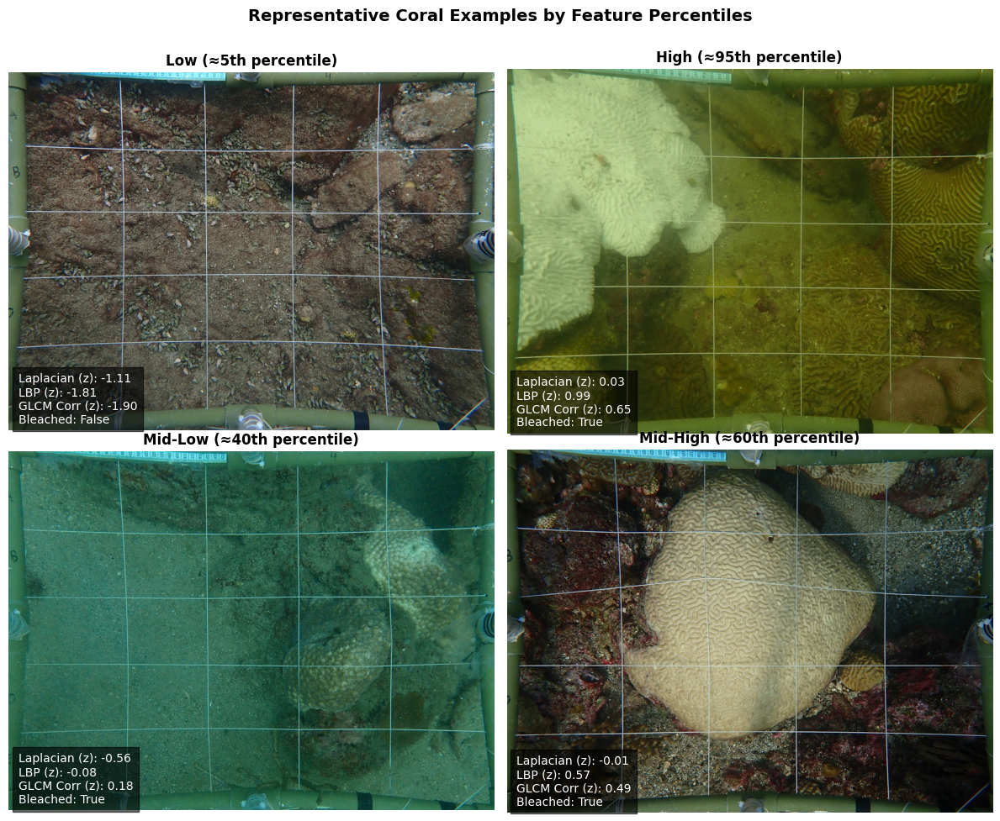

In [ ]:
# ================================================================
# Visualize Representative Examples — Texture Feature Extremes
# ================================================================
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# --- Paths ---
CSV_PATH = "/content/drive/MyDrive/coral_project_outputs/bleaching_texture_features_standardized.csv"
IMG_BASE = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images"  # adjust if needed

# --- Load dataset ---
df = pd.read_csv(CSV_PATH)
feat_cols = ["lap_var_gray_masked_std", "lbp_var_gray_masked_std", "glcm_correlation_std"]
percentiles = df[feat_cols].rank(pct=True)

# --- Function to find closest example to a target percentile ---
def find_closest_to_target(df, percentiles, target):
    dist = ((percentiles - target) ** 2).sum(axis=1)
    return df.loc[dist.idxmin()]

# --- Get 4 representative cases ---
examples = {
    "Low (≈5th percentile)": find_closest_to_target(df, percentiles, 0.05),
    "High (≈95th percentile)": find_closest_to_target(df, percentiles, 0.95),
    "Mid-Low (≈40th percentile)": find_closest_to_target(df, percentiles, 0.40),
    "Mid-High (≈60th percentile)": find_closest_to_target(df, percentiles, 0.60)
}

# --- Visualization ---
fig, axes = plt.subplots(2, 2, figsize=(12, 10))
axes = axes.flatten()

for ax, (title, row) in zip(axes, examples.items()):
    img_path = os.path.join(IMG_BASE, row["image"])
    img = cv2.imread(img_path)
    if img is None:
        ax.text(0.5, 0.5, f"Image not found\n{row['image']}", ha="center", va="center", fontsize=10)
        ax.axis("off")
        continue

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img_rgb)
    ax.set_title(f"{title}", fontsize=12, fontweight="bold")
    ax.axis("off")

    # Feature annotation
    text = (
        f"Laplacian (z): {row['lap_var_gray_masked_std']:.2f}\n"
        f"LBP (z): {row['lbp_var_gray_masked_std']:.2f}\n"
        f"GLCM Corr (z): {row['glcm_correlation_std']:.2f}\n"
        f"Bleached: {row['has_bleached']}"
    )
    ax.text(0.02, 0.02, text, color="white", fontsize=10,
            bbox=dict(facecolor="black", alpha=0.6, pad=5),
            transform=ax.transAxes)

plt.suptitle("Representative Coral Examples by Feature Percentiles", fontsize=14, fontweight="bold")
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


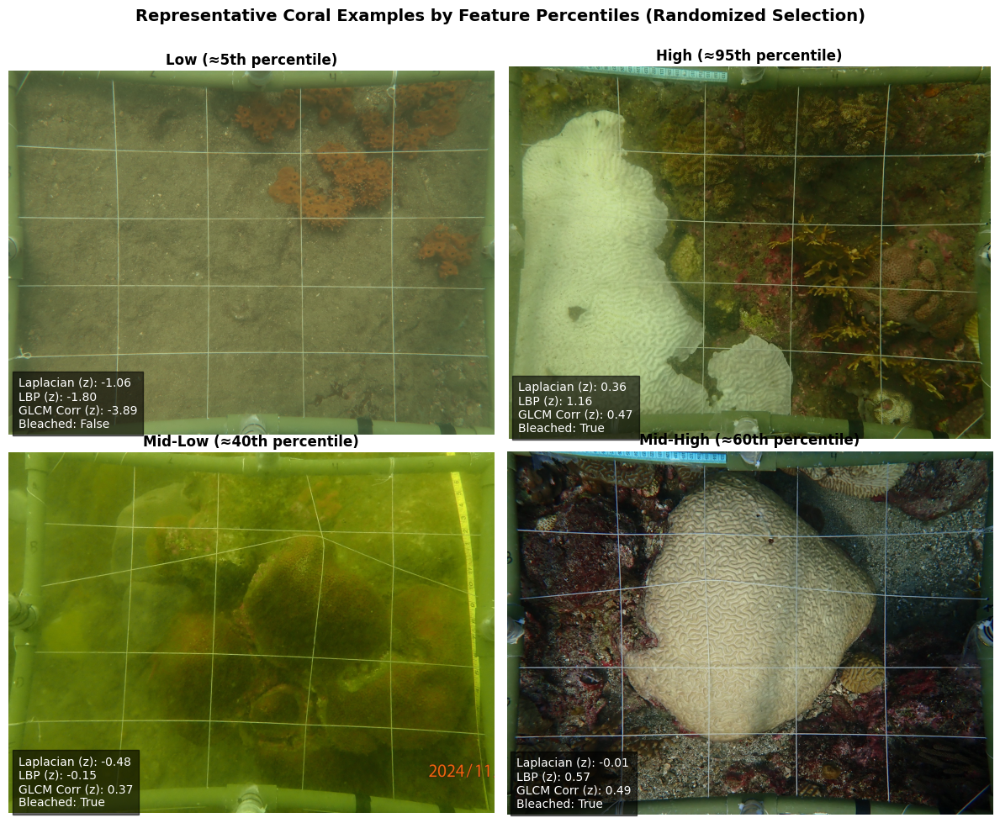

In [ ]:
# ================================================================
# Visualize Randomized Representative Examples — Texture Feature Extremes
# ================================================================
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from random import choice

# --- Paths ---
CSV_PATH = "/content/drive/MyDrive/coral_project_outputs/bleaching_texture_features_standardized.csv"
IMG_BASE = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images"  # adjust as needed

# --- Load dataset ---
df = pd.read_csv(CSV_PATH)
feat_cols = ["lap_var_gray_masked_std", "lbp_var_gray_masked_std", "glcm_correlation_std"]
percentiles = df[feat_cols].rank(pct=True)

# --- Randomized selection around target percentile ---
def find_random_near_target(df, percentiles, target, n_candidates=10):
    dist = ((percentiles - target) ** 2).sum(axis=1)
    closest_indices = dist.nsmallest(n_candidates).index
    return df.loc[choice(closest_indices)]

# --- Get randomized representative cases ---
examples = {
    "Low (≈5th percentile)": find_random_near_target(df, percentiles, 0.05),
    "High (≈95th percentile)": find_random_near_target(df, percentiles, 0.95),
    "Mid-Low (≈40th percentile)": find_random_near_target(df, percentiles, 0.40),
    "Mid-High (≈60th percentile)": find_random_near_target(df, percentiles, 0.60)
}

# --- Visualization ---
fig, axes = plt.subplots(2, 2, figsize=(12, 10))
axes = axes.flatten()

for ax, (title, row) in zip(axes, examples.items()):
    img_path = os.path.join(IMG_BASE, row["image"])
    img = cv2.imread(img_path)
    if img is None:
        ax.text(0.5, 0.5, f"Image not found\n{row['image']}", ha="center", va="center", fontsize=10)
        ax.axis("off")
        continue

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img_rgb)
    ax.set_title(f"{title}", fontsize=12, fontweight="bold")
    ax.axis("off")

    # Annotate features
    text = (
        f"Laplacian (z): {row['lap_var_gray_masked_std']:.2f}\n"
        f"LBP (z): {row['lbp_var_gray_masked_std']:.2f}\n"
        f"GLCM Corr (z): {row['glcm_correlation_std']:.2f}\n"
        f"Bleached: {row['has_bleached']}"
    )
    ax.text(0.02, 0.02, text, color="white", fontsize=10,
            bbox=dict(facecolor="black", alpha=0.6, pad=5),
            transform=ax.transAxes)

plt.suptitle("Representative Coral Examples by Feature Percentiles (Randomized Selection)", fontsize=14, fontweight="bold")
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


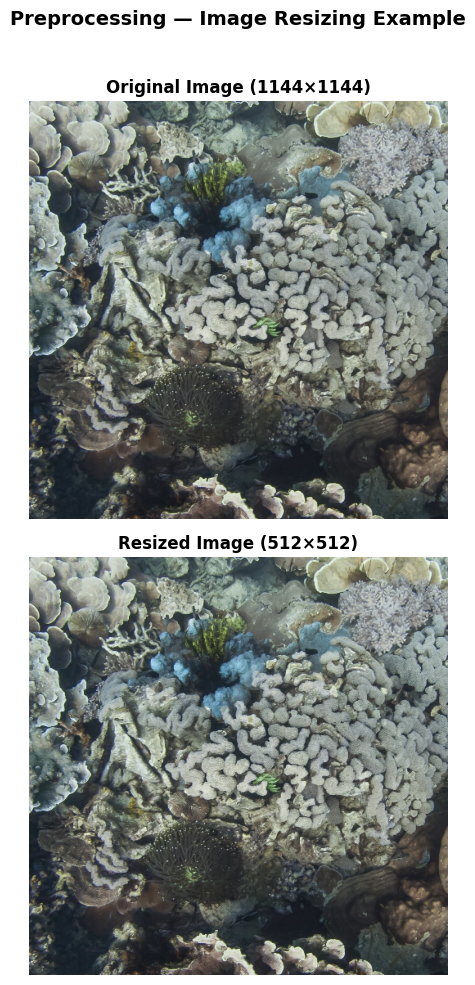

In [ ]:
# ================================================================
# VISUALIZATION 1 — Original vs. Resized Image (Vertical Layout)
# ================================================================
import cv2
import matplotlib.pyplot as plt

img_path = "/content/drive/MyDrive/01_data/benthic_datasets/mask_labels/reef_support/SEAVIEW_IDN_PHL/images/33017058801.jpg"

orig = cv2.imread(img_path)
if orig is None:
    raise FileNotFoundError(f"Image not found: {img_path}")

orig_rgb = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)
resized = cv2.resize(orig_rgb, (512, 512))

fig, axes = plt.subplots(2, 1, figsize=(6, 10))
axes[0].imshow(orig_rgb)
axes[0].set_title(f"Original Image ({orig.shape[1]}×{orig.shape[0]})", fontsize=12, fontweight="bold")
axes[0].axis("off")

axes[1].imshow(resized)
axes[1].set_title("Resized Image (512×512)", fontsize=12, fontweight="bold")
axes[1].axis("off")

plt.suptitle("Preprocessing — Image Resizing Example", fontsize=14, fontweight="bold")
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()



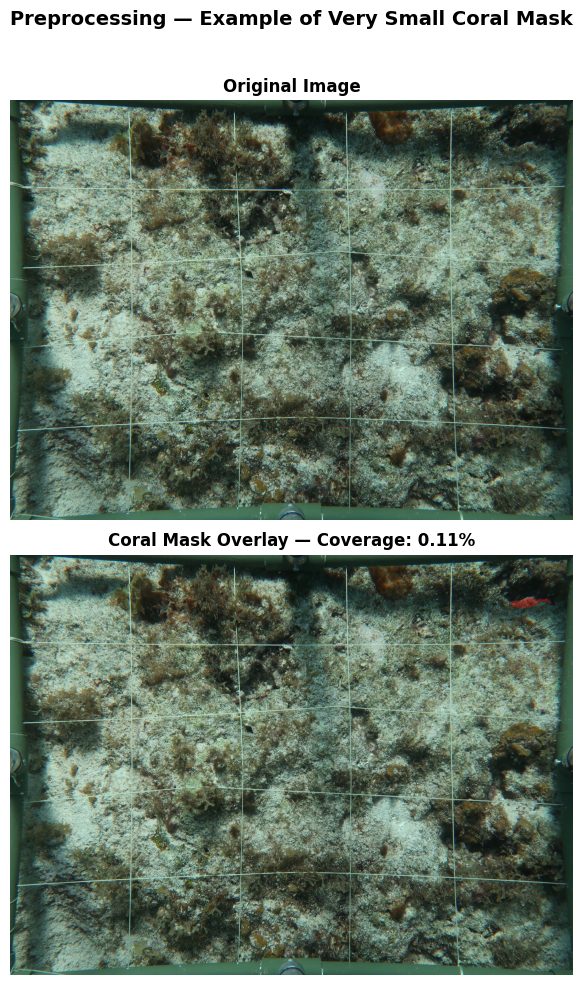

In [ ]:
# ================================================================
# VISUALIZATION 2 — Image–Mask Pair with Very Small Coral Region (Vertical)
# ================================================================
import os, cv2, numpy as np, matplotlib.pyplot as plt

img_path = "/content/drive/MyDrive/01_data/benthic_datasets/mask_labels/reef_support/SEAFLOWER_COURTOWN/images/E17_T3_C8_Corr_24sep22.JPG"
mask_path = "/content/drive/MyDrive/01_data/benthic_datasets/mask_labels/reef_support/SEAFLOWER_COURTOWN/masks_stitched/E17_T3_C8_Corr_24sep22_mask.png"

img = cv2.imread(img_path)
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
if img is None or mask is None:
    raise FileNotFoundError("Check your image/mask paths!")

img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

overlay = img_rgb.copy()
overlay[mask > 0] = (255, 0, 0)
vis = cv2.addWeighted(img_rgb, 0.7, overlay, 0.3, 0)

coverage = np.sum(mask > 0) / (mask.shape[0] * mask.shape[1]) * 100

fig, axes = plt.subplots(2, 1, figsize=(6, 10))
axes[0].imshow(img_rgb)
axes[0].set_title("Original Image", fontsize=12, fontweight="bold")
axes[0].axis("off")

axes[1].imshow(vis)
axes[1].set_title(f"Coral Mask Overlay — Coverage: {coverage:.2f}%", fontsize=12, fontweight="bold")
axes[1].axis("off")

plt.suptitle("Preprocessing — Example of Very Small Coral Mask", fontsize=14, fontweight="bold")
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


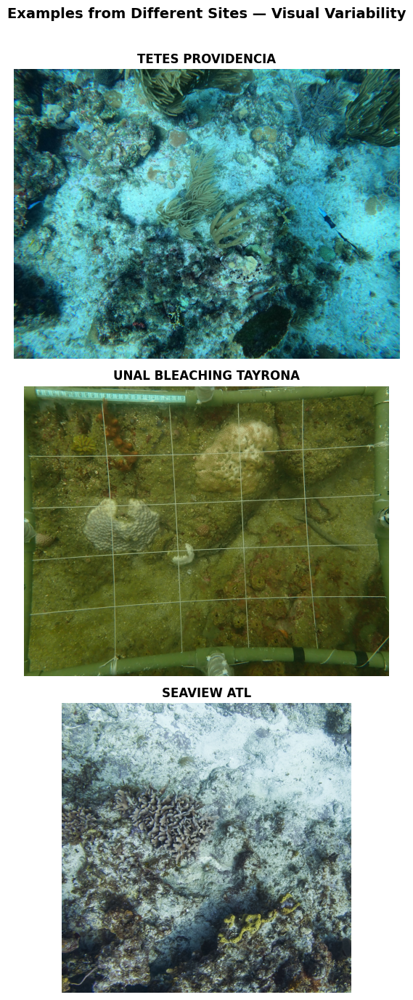

In [ ]:
# ================================================================
# VISUALIZATION 3 — Three Images from Different Sites (Vertical)
# ================================================================
import os, random, cv2, matplotlib.pyplot as plt

sites = [
    "TETES_PROVIDENCIA",
    "UNAL_BLEACHING_TAYRONA",
    "SEAVIEW_ATL"
]

fig, axes = plt.subplots(len(sites), 1, figsize=(6, 14))

for ax, site in zip(axes, sites):
    site_dir = f"/content/drive/MyDrive/01_data/benthic_datasets/mask_labels/reef_support/{site}/images"
    imgs = [f for f in os.listdir(site_dir) if f.lower().endswith(('.jpg', '.png'))]
    if not imgs:
        continue
    img_path = os.path.join(site_dir, random.choice(imgs))
    img = cv2.imread(img_path)
    if img is None:
        continue
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img_rgb)
    ax.set_title(f"{site.replace('_', ' ')}", fontsize=12, fontweight="bold")
    ax.axis("off")

plt.suptitle("Examples from Different Sites — Visual Variability", fontsize=14, fontweight="bold")
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


✅ Texture features: (634, 9),  Color features: (658, 10)
🔗 Merged dataset shape: (634, 20)
📊 Using 11 features for percentile selection.


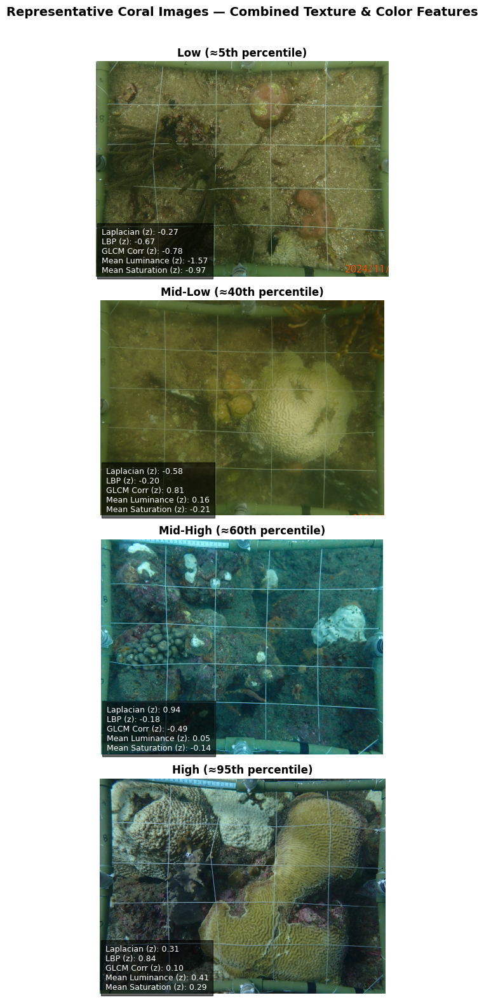

In [ ]:
# ================================================================
# FIXED — Combine Texture & Color Features + Select Representative Images
# ================================================================
import pandas as pd
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
from random import choice

# --- Paths ---
TEXTURE_PATH = "/content/drive/MyDrive/coral_project_outputs/bleaching_texture_features_standardized.csv"
COLOR_PATH   = "/content/drive/MyDrive/coral_project_outputs/standardized_feature_score_per_image.csv"
IMG_BASE     = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images"

# --- Load datasets ---
df_tex = pd.read_csv(TEXTURE_PATH)
df_col = pd.read_csv(COLOR_PATH)

print(f"✅ Texture features: {df_tex.shape},  Color features: {df_col.shape}")

# --- Extract base filename (no extension, no path) ---
df_tex["image_stem"] = df_tex["image"].astype(str).apply(lambda x: os.path.splitext(os.path.basename(x))[0])
df_col["image_stem"] = df_col["image_path"].astype(str).apply(lambda x: os.path.splitext(os.path.basename(x))[0])

# --- Merge ---
df_merged = pd.merge(df_tex, df_col, on="image_stem", how="inner")
print(f"🔗 Merged dataset shape: {df_merged.shape}")

if df_merged.empty:
    raise ValueError("❌ Merge failed — check if image names actually match between the two CSVs.")

# --- Feature columns ---
feature_cols = [
    "lap_var_gray_masked_std",
    "lbp_var_gray_masked_std",
    "glcm_correlation_std",
    "mean_raw_red_z", "mean_albedo_z", "mean_luminance_z",
    "mean_saturation_z", "median_raw_red_z", "median_albedo_z",
    "median_luminance_z", "median_saturation_z"
]
feature_cols = [f for f in feature_cols if f in df_merged.columns]
print(f"📊 Using {len(feature_cols)} features for percentile selection.")

# --- Compute percentile ranks ---
percentiles = df_merged[feature_cols].rank(pct=True)

# --- Randomized selection near target percentile ---
def find_random_near_target(df, percentiles, target, tolerance=0.10):
    dist = ((percentiles - target) ** 2).sum(axis=1)
    close = dist.nsmallest(max(5, int(len(df) * tolerance))).index
    if len(close) == 0:
        return df.iloc[0]
    return df.loc[choice(close)]

# --- Select representative examples ---
examples = {
    "Low (≈5th percentile)": find_random_near_target(df_merged, percentiles, 0.05),
    "Mid-Low (≈40th percentile)": find_random_near_target(df_merged, percentiles, 0.40),
    "Mid-High (≈60th percentile)": find_random_near_target(df_merged, percentiles, 0.60),
    "High (≈95th percentile)": find_random_near_target(df_merged, percentiles, 0.95)
}

# --- Visualization ---
fig, axes = plt.subplots(4, 1, figsize=(8, 16))

for ax, (title, row) in zip(axes, examples.items()):
    img_name = row["image_stem"]
    img_path = os.path.join(IMG_BASE, img_name + ".jpg")
    if not os.path.exists(img_path):
        img_path = os.path.join(IMG_BASE, img_name + ".png")

    img = cv2.imread(img_path)
    if img is None:
        ax.text(0.5, 0.5, f"Image not found\n{img_name}", ha="center", va="center", fontsize=10)
        ax.axis("off")
        continue

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img_rgb)
    ax.set_title(title, fontsize=12, fontweight="bold")
    ax.axis("off")

    text = (
        f"Laplacian (z): {row.get('lap_var_gray_masked_std', 0):.2f}\n"
        f"LBP (z): {row.get('lbp_var_gray_masked_std', 0):.2f}\n"
        f"GLCM Corr (z): {row.get('glcm_correlation_std', 0):.2f}\n"
        f"Mean Luminance (z): {row.get('mean_luminance_z', 0):.2f}\n"
        f"Mean Saturation (z): {row.get('mean_saturation_z', 0):.2f}"
    )
    ax.text(0.02, 0.02, text, color="white", fontsize=9,
            bbox=dict(facecolor="black", alpha=0.6, pad=5),
            transform=ax.transAxes)

plt.suptitle("Representative Coral Images — Combined Texture & Color Features", fontsize=14, fontweight="bold")
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


✅ Texture shape: (634, 10), Color shape: (634, 12)
🔗 Merged dataset: (634, 23)
📊 Using 2 features


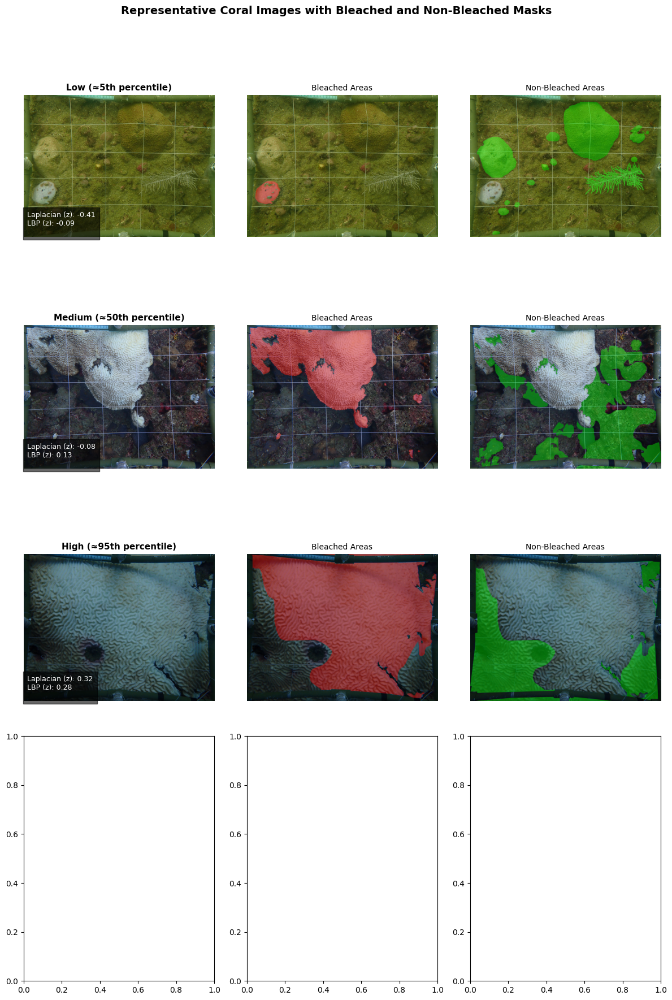

In [ ]:
# ================================================================
# Coral Visualization — Correct Mask Matching (_bleached/_non_bleached)
# ================================================================
import os, cv2, glob, re, numpy as np, pandas as pd
import matplotlib.pyplot as plt
from random import choice

# --- Paths ---
TEXTURE_PATH = "/content/drive/MyDrive/coral_project_outputs/bleaching_texture_with_score.csv"
COLOR_PATH   = "/content/drive/MyDrive/coral_project_outputs/whiteness_scores_added.csv"

IMG_BASE          = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images"
MASK_BLEACHED_DIR = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/masks_bleached"
MASK_NONBLEACHED_DIR = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/masks_non_bleached"

# --- Helper: search for mask file matching the exact stem ---
def find_mask(base_dir, name_stem, suffix):
    for ext in [".png", ".PNG", ".jpg", ".JPG"]:
        candidate = os.path.join(base_dir, f"{name_stem}{suffix}{ext}")
        if os.path.exists(candidate):
            return candidate
    return None

# --- Load data ---
df_tex = pd.read_csv(TEXTURE_PATH)
df_col = pd.read_csv(COLOR_PATH)
print(f"✅ Texture shape: {df_tex.shape}, Color shape: {df_col.shape}")

# --- Image stem (keep annotator name) ---
def clean_stem(x):
    return os.path.splitext(os.path.basename(str(x)))[0]

df_tex["image_stem"] = df_tex["image"].apply(clean_stem)
df_col["image_stem"] = df_col["image_path"].apply(clean_stem)

# Merge both datasets
df_merged = pd.merge(df_tex, df_col, on="image_stem", how="inner")
print(f"🔗 Merged dataset: {df_merged.shape}")

# --- Feature columns to use ---
feature_cols = [
  "median_whiteness_score",
  "texture_score"
]
feature_cols = [f for f in feature_cols if f in df_merged.columns]
print(f"📊 Using {len(feature_cols)} features")

# --- Compute percentiles ---
percentiles = df_merged[feature_cols].rank(pct=True)

def find_random_near_target(df, percentiles, target, tol=0.1):
    dist = ((percentiles - target) ** 2).sum(axis=1)
    close = dist.nsmallest(max(5, int(len(df) * tol))).index
    if len(close) == 0:
        return df.iloc[0]
    return df.loc[choice(close)]

# --- Pick examples across the spectrum ---
examples = {
    "Low (≈5th percentile)": find_random_near_target(df_merged, percentiles, 0.05),
    "Medium (≈50th percentile)": find_random_near_target(df_merged, percentiles, 0.50),
    "High (≈95th percentile)": find_random_near_target(df_merged, percentiles, 0.95)
}

# --- Visualization ---
fig, axes = plt.subplots(4, 3, figsize=(12, 18))
axes = axes.reshape(4, 3)

for i, (title, row) in enumerate(examples.items()):
    name = row["image_stem"]
    img_path = os.path.join(IMG_BASE, f"{name}.jpg")
    if not os.path.exists(img_path):
        img_path = os.path.join(IMG_BASE, f"{name}.JPG")

    mask_b_path = find_mask(MASK_BLEACHED_DIR, name, "_bleached")
    mask_nb_path = find_mask(MASK_NONBLEACHED_DIR, name, "_non_bleached")

    img = cv2.imread(img_path) if img_path and os.path.exists(img_path) else None
    mask_b = cv2.imread(mask_b_path, cv2.IMREAD_GRAYSCALE) if mask_b_path else None
    mask_nb = cv2.imread(mask_nb_path, cv2.IMREAD_GRAYSCALE) if mask_nb_path else None

    # --- Original image ---
    ax = axes[i, 0]
    if img is not None:
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    else:
        ax.text(0.5, 0.5, f"Image not found\n{name}", ha="center", va="center")
    ax.set_title(title, fontsize=11, fontweight="bold")
    ax.axis("off")

    text = (
      f"Laplacian (z): {row.get('median_whiteness_score', 0):.2f}\n"
      f"LBP (z): {row.get('texture_score', 0):.2f}\n"
    )

    ax.text(0.02, 0.02, text, color="white", fontsize=9,
            bbox=dict(facecolor="black", alpha=0.6, pad=5),
            transform=ax.transAxes)

    # --- Bleached overlay ---
    ax = axes[i, 1]
    if img is not None and mask_b is not None:
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        overlay = img_rgb.copy()
        overlay[mask_b > 0] = [255, 0, 0]
        blended = cv2.addWeighted(img_rgb, 0.6, overlay, 0.4, 0)
        ax.imshow(blended)
    else:
        ax.text(0.5, 0.5, "Bleached mask missing", ha="center", va="center")
    ax.set_title("Bleached Areas", fontsize=10)
    ax.axis("off")

    # --- Non-Bleached overlay ---
    ax = axes[i, 2]
    if img is not None and mask_nb is not None:
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        overlay = img_rgb.copy()
        overlay[mask_nb > 0] = [0, 255, 0]
        blended = cv2.addWeighted(img_rgb, 0.6, overlay, 0.4, 0)
        ax.imshow(blended)
    else:
        ax.text(0.5, 0.5, "Non-bleached mask missing", ha="center", va="center")
    ax.set_title("Non-Bleached Areas", fontsize=10)
    ax.axis("off")

plt.suptitle("Representative Coral Images with Bleached and Non-Bleached Masks", fontsize=14, fontweight="bold")
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


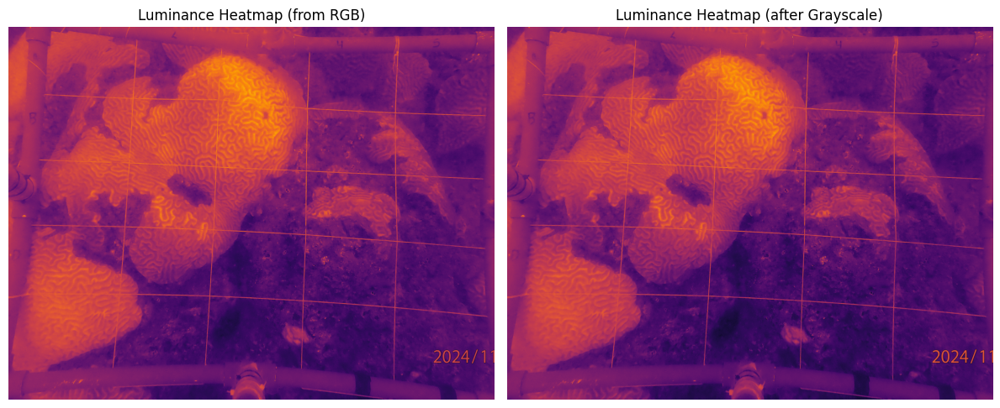

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os

# --- Path to your image ---
IMG_PATH = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images/C14_BC_PM_T3_29nov24_CDaza_corr.jpg"

# --- Load image ---
img_bgr = cv2.imread(IMG_PATH)
if img_bgr is None:
    raise FileNotFoundError(f"Image not found: {IMG_PATH}")

# Convert to RGB for visualization
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# --- Compute luminance from RGB ---
# Standard luminance formula (ITU-R BT.709)
luminance_rgb = 0.2126 * img_rgb[:, :, 0] + 0.7152 * img_rgb[:, :, 1] + 0.0722 * img_rgb[:, :, 2]

# --- Convert to grayscale first, then compute luminance again ---
gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
# Normalize to same scale
luminance_gray = cv2.normalize(gray.astype(np.float32), None, 0, 255, cv2.NORM_MINMAX)

# --- Plot ---
plt.figure(figsize=(12,5))

plt.subplot(1,2,1)
plt.imshow(luminance_rgb, cmap='inferno')
plt.title("Luminance Heatmap (from RGB)")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(luminance_gray, cmap='inferno')
plt.title("Luminance Heatmap (after Grayscale)")
plt.axis("off")

plt.tight_layout()
plt.show()


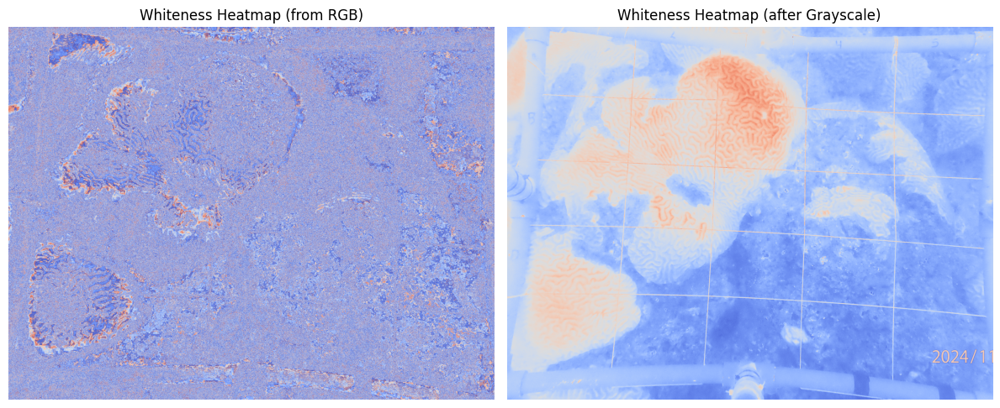

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# --- Path to your image ---
IMG_PATH = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images/C14_BC_PM_T3_29nov24_CDaza_corr.jpg"

# --- Load image ---
img_bgr = cv2.imread(IMG_PATH)
if img_bgr is None:
    raise FileNotFoundError(f"Image not found: {IMG_PATH}")

img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# --- Compute whiteness from RGB ---
# Distance from white (255,255,255)
whiteness_rgb = 255 - np.sqrt(
    (255 - img_rgb[:, :, 0])**2 +
    (255 - img_rgb[:, :, 1])**2 +
    (255 - img_rgb[:, :, 2])**2
) / np.sqrt(3)

# Normalize to [0,1] for display
whiteness_rgb_norm = cv2.normalize(whiteness_rgb, None, 0, 1, cv2.NORM_MINMAX)

# --- Convert to grayscale and compute whiteness again ---
gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
whiteness_gray = 255 - np.abs(gray.astype(np.float32) - 255)
whiteness_gray_norm = cv2.normalize(whiteness_gray, None, 0, 1, cv2.NORM_MINMAX)

# --- Plot ---
plt.figure(figsize=(12,5))

plt.subplot(1,2,1)
plt.imshow(whiteness_rgb_norm, cmap='coolwarm')
plt.title("Whiteness Heatmap (from RGB)")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(whiteness_gray_norm, cmap='coolwarm')
plt.title("Whiteness Heatmap (after Grayscale)")
plt.axis("off")

plt.tight_layout()
plt.show()


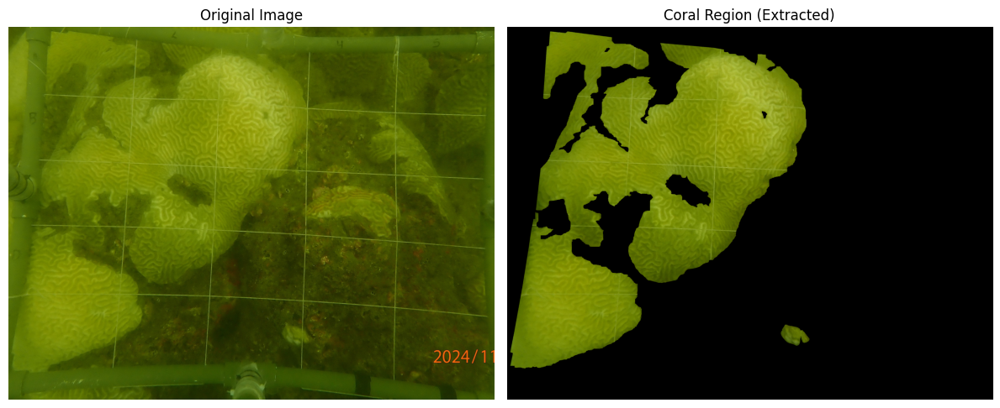

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# --- Paths ---
IMG_NAME = "C14_BC_PM_T3_29nov24_CDaza_corr.jpg"

IMG_DIR = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images"
MASK_BLEACHED_DIR = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/masks_bleached"
MASK_NONBLEACHED_DIR = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/masks_non_bleached"

# --- Load image ---
img_path = os.path.join(IMG_DIR, IMG_NAME)
img_bgr = cv2.imread(img_path)
if img_bgr is None:
    raise FileNotFoundError(f"❌ Image not found: {img_path}")

img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# --- Derive mask path (based on image name pattern) ---
stem = os.path.splitext(IMG_NAME)[0]
mask_path = os.path.join(MASK_BLEACHED_DIR, f"{stem}_bleached.png")
if not os.path.exists(mask_path):
    mask_path = os.path.join(MASK_NONBLEACHED_DIR, f"{stem}_non_bleached.png")

mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
if mask is None:
    raise FileNotFoundError(f"❌ Mask not found for: {IMG_NAME}")

# --- Apply mask to image ---
mask_binary = (mask > 0).astype(np.uint8)
masked_img = cv2.bitwise_and(img_rgb, img_rgb, mask=mask_binary)

# --- Visualize ---
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.imshow(img_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(masked_img)
plt.title("Coral Region (Extracted)")
plt.axis("off")

plt.tight_layout()
plt.show()


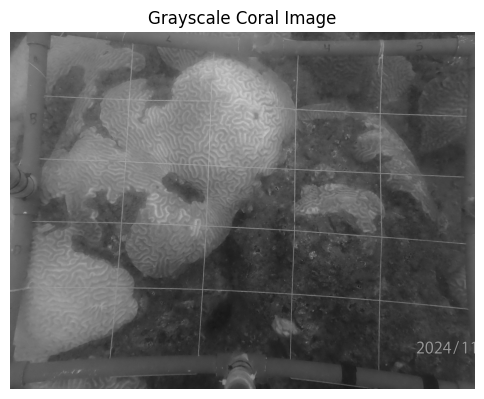

In [ ]:
import cv2
import matplotlib.pyplot as plt
import os

# --- Path to your image ---
IMG_PATH = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images/C14_BC_PM_T3_29nov24_CDaza_corr.jpg"

# --- Load and convert to grayscale ---
img_bgr = cv2.imread(IMG_PATH)
if img_bgr is None:
    raise FileNotFoundError(f"❌ Image not found: {IMG_PATH}")

gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)

# --- Show ---
plt.figure(figsize=(6,6))
plt.imshow(gray, cmap='gray')
plt.title("Grayscale Coral Image")
plt.axis("off")
plt.show()


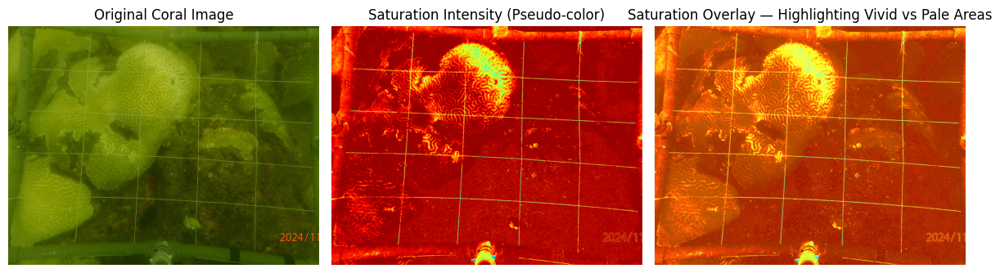

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# --- Load coral image ---
IMG_PATH = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images/C14_BC_PM_T3_29nov24_CDaza_corr.jpg"
img_bgr = cv2.imread(IMG_PATH)
if img_bgr is None:
    raise FileNotFoundError(f"❌ Image not found: {IMG_PATH}")
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# --- Convert to HSV and extract saturation ---
hsv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)
saturation = hsv[:, :, 1].astype(np.float32)
saturation_norm = cv2.normalize(saturation, None, 0, 1, cv2.NORM_MINMAX)

# --- Create a pseudo-color map (blue = pale, red = vivid) ---
pseudo_color = cv2.applyColorMap((saturation_norm * 255).astype(np.uint8), cv2.COLORMAP_JET)
pseudo_color = cv2.cvtColor(pseudo_color, cv2.COLOR_BGR2RGB)

# --- Overlay on original image (for interpretability) ---
overlay = cv2.addWeighted(img_rgb, 0.6, pseudo_color, 0.8, 0)

# --- Display ---
plt.figure(figsize=(12,5))

plt.subplot(1,3,1)
plt.imshow(img_rgb)
plt.title("Original Coral Image")
plt.axis("off")

plt.subplot(1,3,2)
plt.imshow(pseudo_color)
plt.title("Saturation Intensity (Pseudo-color)")
plt.axis("off")

plt.subplot(1,3,3)
plt.imshow(overlay)
plt.title("Saturation Overlay — Highlighting Vivid vs Pale Areas")
plt.axis("off")

plt.tight_layout()
plt.show()


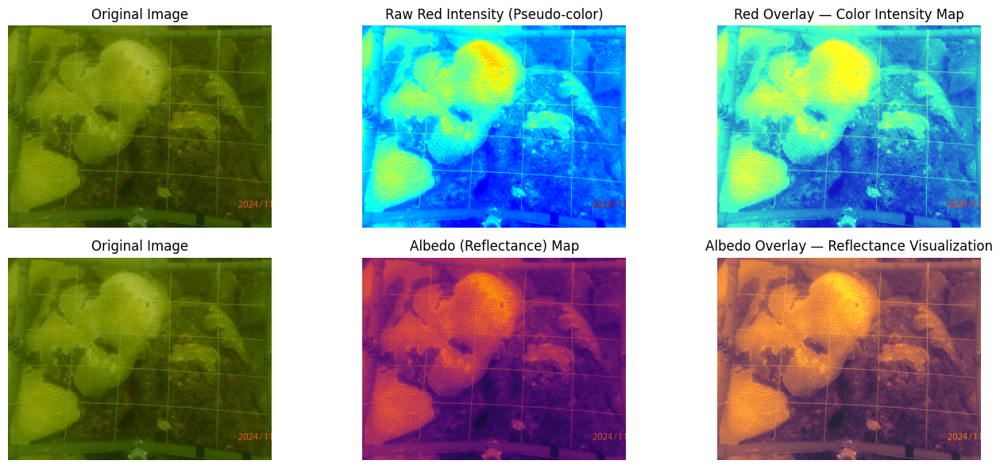

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# --- Image path ---
IMG_PATH = "/content/drive/MyDrive/01_data/coral_bleaching/reef_support/UNAL_BLEACHING_TAYRONA/images/C14_BC_PM_T3_29nov24_CDaza_corr.jpg"
img_bgr = cv2.imread(IMG_PATH)
if img_bgr is None:
    raise FileNotFoundError(f"❌ Image not found: {IMG_PATH}")

img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# ============================================================
# 1️⃣ RAW RED VISUALIZATION
# ============================================================
red_channel = img_rgb[:, :, 0].astype(np.float32)
red_norm = cv2.normalize(red_channel, None, 0, 1, cv2.NORM_MINMAX)

# Pseudo-color map for red intensity
red_map = cv2.applyColorMap((red_norm * 255).astype(np.uint8), cv2.COLORMAP_JET)
red_map = cv2.cvtColor(red_map, cv2.COLOR_BGR2RGB)
red_overlay = cv2.addWeighted(img_rgb, 0.6, red_map, 0.8, 0)

# ============================================================
# 2️⃣ ALBEDO (REFLECTANCE) VISUALIZATION
# ============================================================
# Approximate albedo as normalized image brightness (intensity)
gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY).astype(np.float32)
albedo = cv2.normalize(gray, None, 0, 1, cv2.NORM_MINMAX)

# Pseudo-color map for albedo (white = high reflectance)
albedo_map = cv2.applyColorMap((albedo * 255).astype(np.uint8), cv2.COLORMAP_INFERNO)
albedo_map = cv2.cvtColor(albedo_map, cv2.COLOR_BGR2RGB)
albedo_overlay = cv2.addWeighted(img_rgb, 0.6, albedo_map, 0.8, 0)

# ============================================================
# 3️⃣ DISPLAY RESULTS
# ============================================================
plt.figure(figsize=(14,6))

# Raw Red
plt.subplot(2,3,1)
plt.imshow(img_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(2,3,2)
plt.imshow(red_map)
plt.title("Raw Red Intensity (Pseudo-color)")
plt.axis("off")

plt.subplot(2,3,3)
plt.imshow(red_overlay)
plt.title("Red Overlay — Color Intensity Map")
plt.axis("off")

# Albedo
plt.subplot(2,3,4)
plt.imshow(img_rgb)
plt.title("Original Image")
plt.axis("off")

plt.subplot(2,3,5)
plt.imshow(albedo_map)
plt.title("Albedo (Reflectance) Map")
plt.axis("off")

plt.subplot(2,3,6)
plt.imshow(albedo_overlay)
plt.title("Albedo Overlay — Reflectance Visualization")
plt.axis("off")

plt.tight_layout()
plt.show()
